# Finding a latent space representation for Ayaneru
### WIth feature, pixel, and target propagation loss
### And automatic cropping with dlib
### Constraining input to be orthogonal
### Using the FaceSpace API

In [1]:
%load_ext autoreload
%autoreload 2
from FaceSpace import PreprocessFaceDir, MakeFaceData, MakeFaceModel, TrainFaceModel
from FaceSpace import SaveFaceSpace, LoadFaceSpace, GetFaceFromZSpace, ShowFace 

### 1. Preprocess raw photos to get cropped, aligned photos

In [28]:
RawImagesPath = 'Ayaneru FaceSpace/images'
AlignedImagesPath = 'Ayaneru FaceSpace/images/aligned'
PreprocessFaceDir(RawImagesPath, AlignedImagesPath)

### 2. Make FaceData object based on aligned images
#### FaceData contains Zspace (one-hot encoded, orthogonal vectors for each face), a to-be-learned Wspace, tensor representations of faces, and feature maps of faces

Getting tensors of (aligned) face images
ZDims unspecified, setting equal to Size:  6
Using default Zspace - identity matrix (orthogonal vectors) of dim  6
Using default Wspace - zero matrix of dim  6


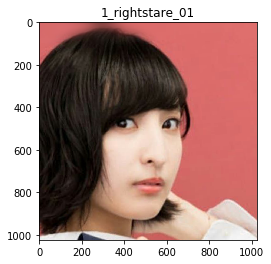

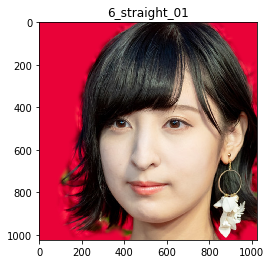

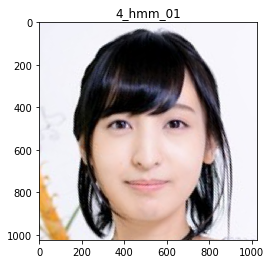

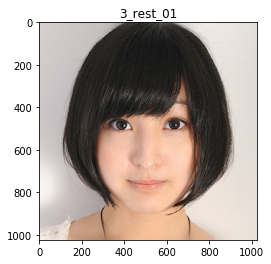

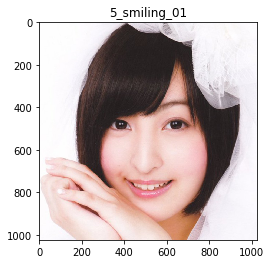

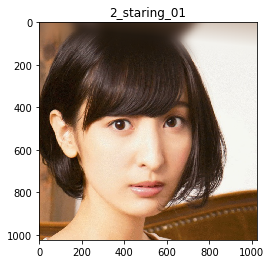

Reshaped Wspace to match number of stored faces, Wspace dim:  torch.Size([6, 18, 512])
Getting feature maps for training...


/home/tsehao/anaconda3/envs/tth20191007/lib/python3.7/site-packages/torch/nn/functional.py:2479: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


Done


In [2]:
FaceData = MakeFaceData('Ayaneru FaceSpace/images/aligned')

### 3. Make FaceModel based on FaceData object
#### FaceModel is a StyleGAN with the mapping network replaced with a decompression encoder

In [3]:
FaceModel = MakeFaceModel(FaceData)

No Zdims explicitly specified, inferring Zdims from FaceData, Zdims=6


### 4. Train the FaceModel to map orthogonal Zspace to an extended Wspace using feature, pixel, and target propagation loss using a learned Wspace

Cycle:  1 LR:  0.01
Epoch:  1
Batch:  1
This batch:  ['5_smiling_01', '6_straight_01']
Total time elapsed:  0.5402774810791016  s
W+ loss:  15464.2724609375
Feature loss:  165.63214111328125  | Pixel loss:  0.24619591236114502  | Target prop loss:  6.708253383636475
Weighted - Feature loss:  16563.214111328125  | Pixel loss:  24.619591236114502  | Target prop loss:  67082.53383636475
Total loss:  83670.3671875


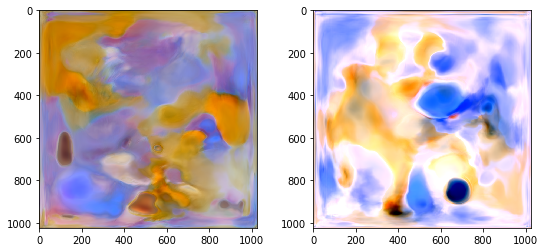

Target W+ output


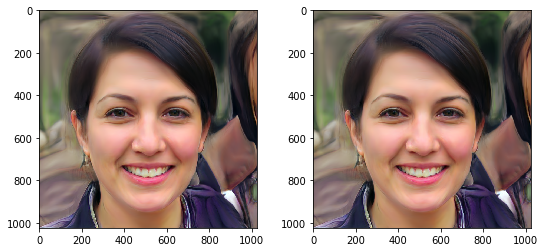

Epoch:  1
Batch:  2
This batch:  ['4_hmm_01', '2_staring_01']
Total time elapsed:  1.8653621673583984  s
W+ loss:  13264.087890625
Feature loss:  118.26264953613281  | Pixel loss:  0.2721848785877228  | Target prop loss:  3.4643681049346924
Weighted - Feature loss:  11826.264953613281  | Pixel loss:  27.218487858772278  | Target prop loss:  34643.681049346924
Total loss:  46497.1640625


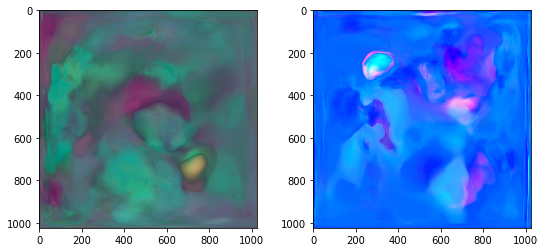

Target W+ output


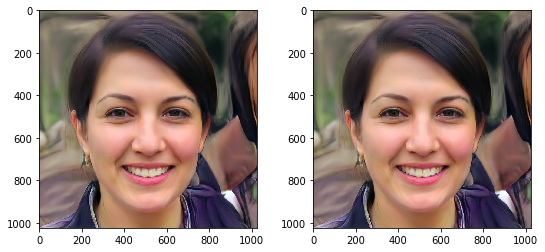

Epoch:  1
Batch:  3
This batch:  ['3_rest_01', '1_rightstare_01']
Total time elapsed:  3.2261602878570557  s
W+ loss:  12407.5283203125
Feature loss:  88.3582763671875  | Pixel loss:  0.17917032539844513  | Target prop loss:  1.8571372032165527
Weighted - Feature loss:  8835.82763671875  | Pixel loss:  17.917032539844513  | Target prop loss:  18571.372032165527
Total loss:  27425.1171875


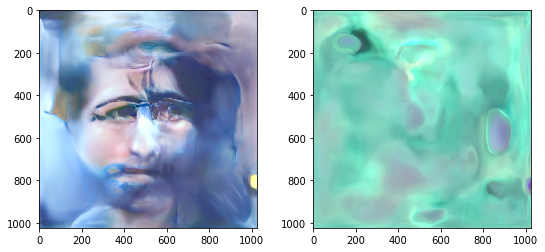

Target W+ output


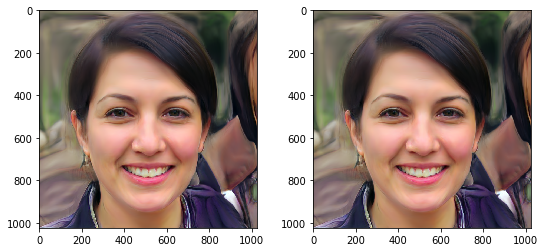

Epoch:  25
Batch:  1
This batch:  ['2_staring_01', '3_rest_01']
Total time elapsed:  39.15248370170593  s
W+ loss:  5309.22412109375
Feature loss:  55.02607345581055  | Pixel loss:  0.07431010156869888  | Target prop loss:  0.02103233151137829
Weighted - Feature loss:  5502.607345581055  | Pixel loss:  7.431010156869888  | Target prop loss:  210.32331511378288
Total loss:  5720.36181640625


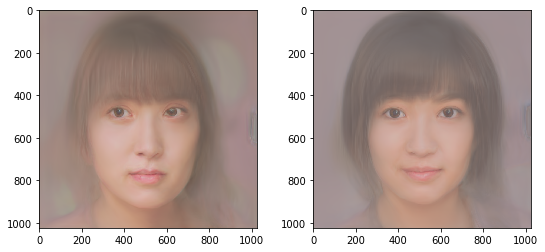

Target W+ output


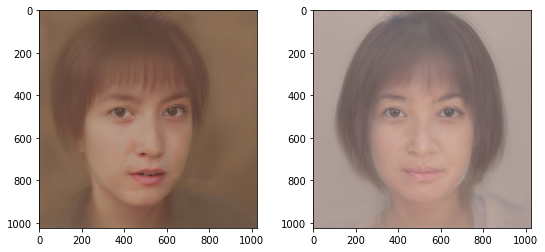

Epoch:  25
Batch:  2
This batch:  ['5_smiling_01', '4_hmm_01']
Total time elapsed:  40.44672203063965  s
W+ loss:  5929.67822265625
Feature loss:  58.755672454833984  | Pixel loss:  0.08766486495733261  | Target prop loss:  0.020248549059033394
Weighted - Feature loss:  5875.567245483398  | Pixel loss:  8.766486495733261  | Target prop loss:  202.48549059033394
Total loss:  6086.8193359375


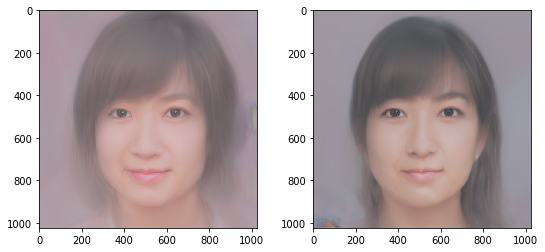

Target W+ output


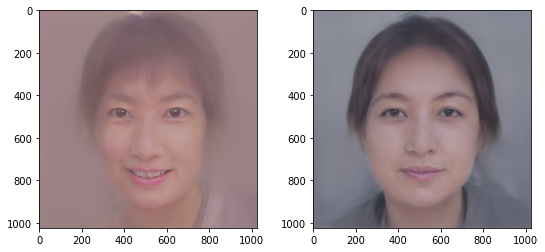

Epoch:  25
Batch:  3
This batch:  ['6_straight_01', '1_rightstare_01']
Total time elapsed:  41.748116970062256  s
W+ loss:  8084.54931640625
Feature loss:  78.19034576416016  | Pixel loss:  0.0667547807097435  | Target prop loss:  0.03683111071586609
Weighted - Feature loss:  7819.034576416016  | Pixel loss:  6.67547807097435  | Target prop loss:  368.3111071586609
Total loss:  8194.021484375


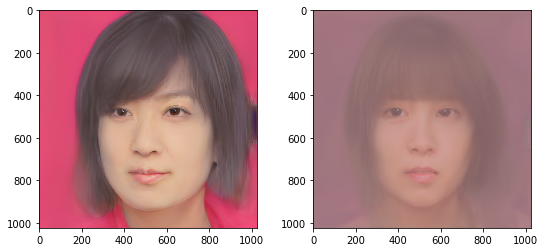

Target W+ output


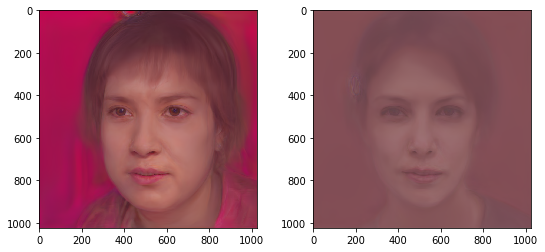

Epoch:  50
Batch:  1
This batch:  ['5_smiling_01', '1_rightstare_01']
Total time elapsed:  79.33789944648743  s
W+ loss:  5425.76953125
Feature loss:  51.68000030517578  | Pixel loss:  0.06342143565416336  | Target prop loss:  0.03390716761350632
Weighted - Feature loss:  5168.000030517578  | Pixel loss:  6.342143565416336  | Target prop loss:  339.07167613506317
Total loss:  5513.4140625


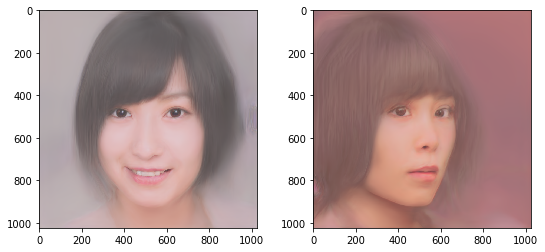

Target W+ output


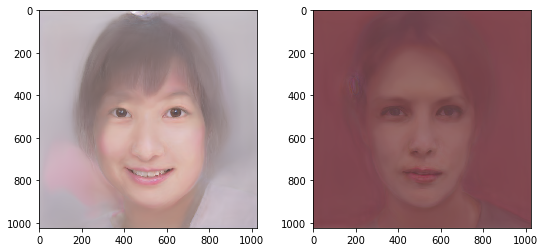

Epoch:  50
Batch:  2
This batch:  ['6_straight_01', '2_staring_01']
Total time elapsed:  80.64345836639404  s
W+ loss:  7394.26025390625
Feature loss:  74.87779998779297  | Pixel loss:  0.04876421019434929  | Target prop loss:  0.03638463094830513
Weighted - Feature loss:  7487.779998779297  | Pixel loss:  4.876421019434929  | Target prop loss:  363.8463094830513
Total loss:  7856.50244140625


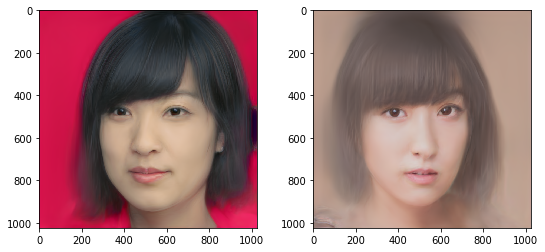

Target W+ output


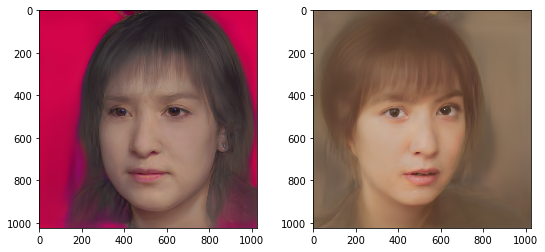

Epoch:  50
Batch:  3
This batch:  ['4_hmm_01', '3_rest_01']
Total time elapsed:  82.00845408439636  s
W+ loss:  4154.90380859375
Feature loss:  42.78312301635742  | Pixel loss:  0.034955091774463654  | Target prop loss:  0.022222328931093216
Weighted - Feature loss:  4278.312301635742  | Pixel loss:  3.4955091774463654  | Target prop loss:  222.22328931093216
Total loss:  4504.03125


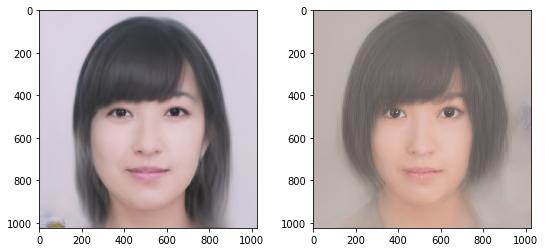

Target W+ output


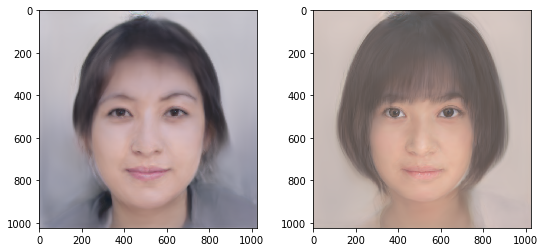

Epoch:  75
Batch:  1
This batch:  ['5_smiling_01', '4_hmm_01']
Total time elapsed:  119.58314871788025  s
W+ loss:  4591.88623046875
Feature loss:  48.4263916015625  | Pixel loss:  0.04051361605525017  | Target prop loss:  0.03393305465579033
Weighted - Feature loss:  4842.63916015625  | Pixel loss:  4.051361605525017  | Target prop loss:  339.3305465579033
Total loss:  5186.02099609375


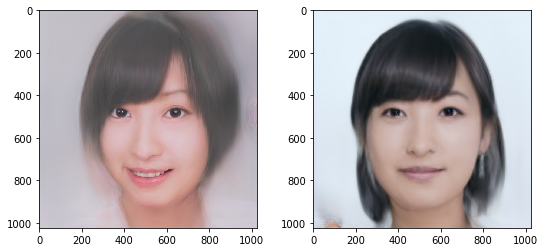

Target W+ output


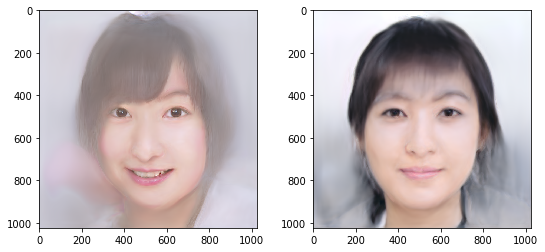

Epoch:  75
Batch:  2
This batch:  ['6_straight_01', '2_staring_01']
Total time elapsed:  120.88928294181824  s
W+ loss:  6776.4677734375
Feature loss:  68.15303802490234  | Pixel loss:  0.04259933531284332  | Target prop loss:  0.03702680021524429
Weighted - Feature loss:  6815.303802490234  | Pixel loss:  4.259933531284332  | Target prop loss:  370.26800215244293
Total loss:  7189.83154296875


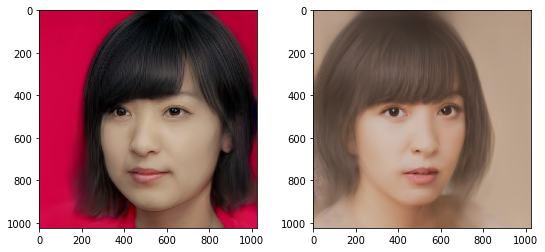

Target W+ output


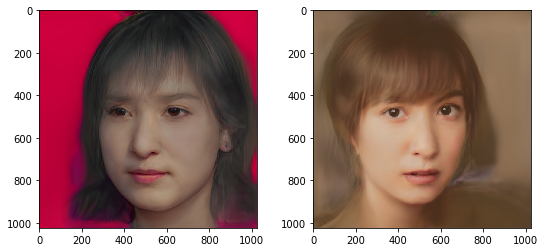

Epoch:  75
Batch:  3
This batch:  ['3_rest_01', '1_rightstare_01']
Total time elapsed:  122.22440004348755  s
W+ loss:  4185.90087890625
Feature loss:  37.57627487182617  | Pixel loss:  0.03221648186445236  | Target prop loss:  0.03413951024413109
Weighted - Feature loss:  3757.627487182617  | Pixel loss:  3.221648186445236  | Target prop loss:  341.3951024413109
Total loss:  4102.244140625


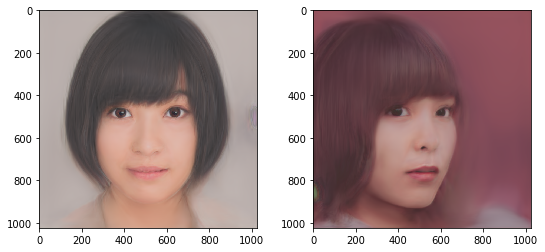

Target W+ output


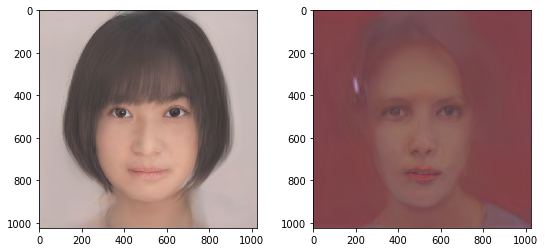

Epoch:  100
Batch:  1
This batch:  ['6_straight_01', '3_rest_01']
Total time elapsed:  159.72186660766602  s
W+ loss:  4982.05126953125
Feature loss:  48.1222038269043  | Pixel loss:  0.02129126526415348  | Target prop loss:  0.03857193514704704
Weighted - Feature loss:  4812.22038269043  | Pixel loss:  2.129126526415348  | Target prop loss:  385.71935147047043
Total loss:  5200.068359375


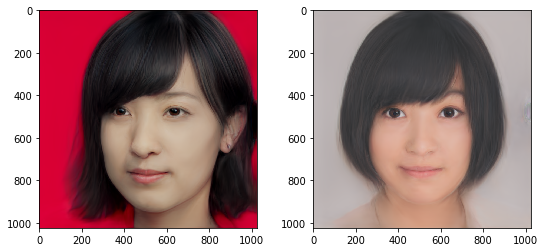

Target W+ output


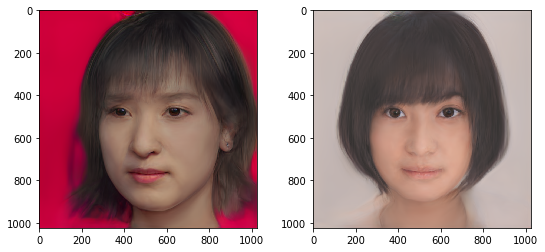

Epoch:  100
Batch:  2
This batch:  ['2_staring_01', '1_rightstare_01']
Total time elapsed:  161.02232432365417  s
W+ loss:  5150.53515625
Feature loss:  45.23819351196289  | Pixel loss:  0.037237439304590225  | Target prop loss:  0.03750541806221008
Weighted - Feature loss:  4523.819351196289  | Pixel loss:  3.7237439304590225  | Target prop loss:  375.05418062210083
Total loss:  4902.59716796875


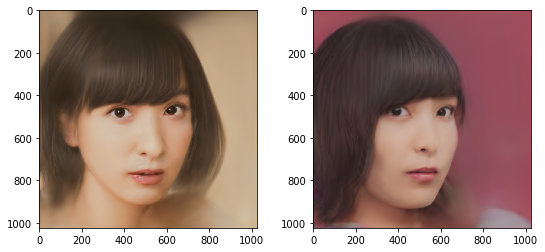

Target W+ output


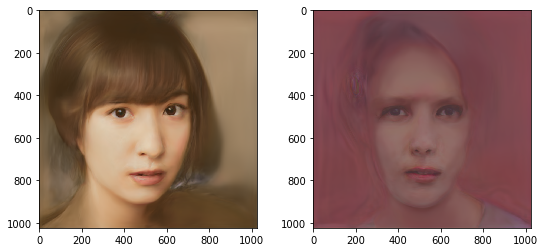

Epoch:  100
Batch:  3
This batch:  ['5_smiling_01', '4_hmm_01']
Total time elapsed:  162.3842945098877  s
W+ loss:  4285.3740234375
Feature loss:  45.52760696411133  | Pixel loss:  0.03232276812195778  | Target prop loss:  0.03812079131603241
Weighted - Feature loss:  4552.760696411133  | Pixel loss:  3.232276812195778  | Target prop loss:  381.2079131603241
Total loss:  4937.201171875


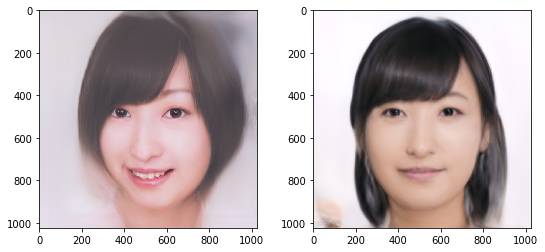

Target W+ output


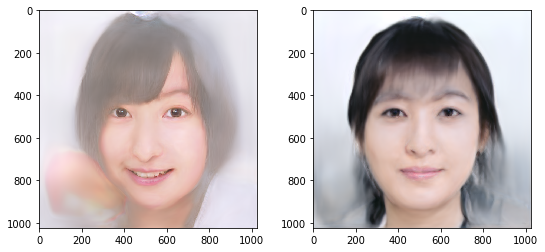

Epoch:  125
Batch:  1
This batch:  ['2_staring_01', '4_hmm_01']
Total time elapsed:  199.55382370948792  s
W+ loss:  4339.9912109375
Feature loss:  42.625694274902344  | Pixel loss:  0.030327508226037025  | Target prop loss:  0.03972994163632393
Weighted - Feature loss:  4262.569427490234  | Pixel loss:  3.0327508226037025  | Target prop loss:  397.2994163632393
Total loss:  4662.9013671875


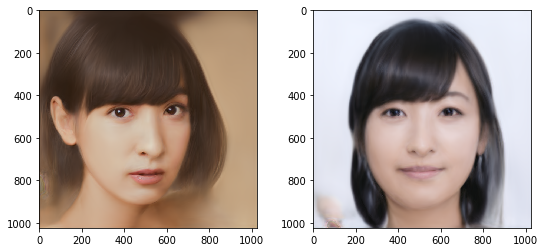

Target W+ output


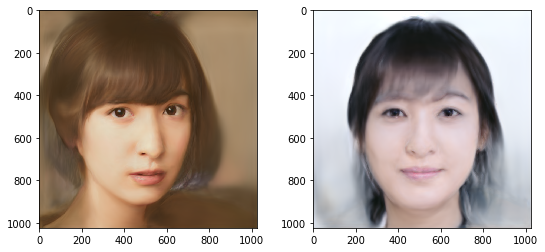

Epoch:  125
Batch:  2
This batch:  ['6_straight_01', '1_rightstare_01']
Total time elapsed:  200.83946251869202  s
W+ loss:  5858.1884765625
Feature loss:  50.64890670776367  | Pixel loss:  0.02670978754758835  | Target prop loss:  0.04683372750878334
Weighted - Feature loss:  5064.890670776367  | Pixel loss:  2.670978754758835  | Target prop loss:  468.3372750878334
Total loss:  5535.89892578125


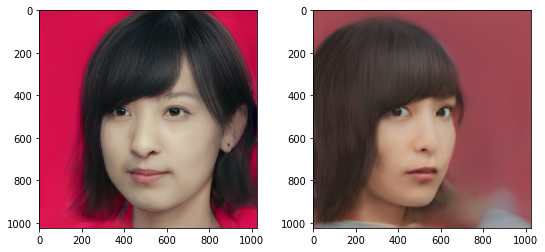

Target W+ output


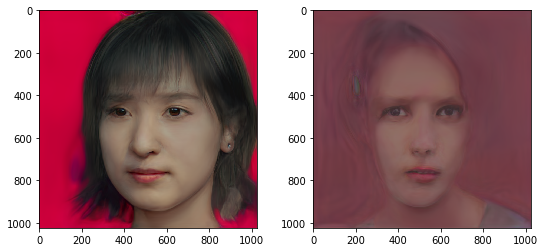

Epoch:  125
Batch:  3
This batch:  ['3_rest_01', '5_smiling_01']
Total time elapsed:  202.1290304660797  s
W+ loss:  3583.580322265625
Feature loss:  37.5090217590332  | Pixel loss:  0.024569250643253326  | Target prop loss:  0.03828239068388939
Weighted - Feature loss:  3750.9021759033203  | Pixel loss:  2.4569250643253326  | Target prop loss:  382.8239068388939
Total loss:  4136.18310546875


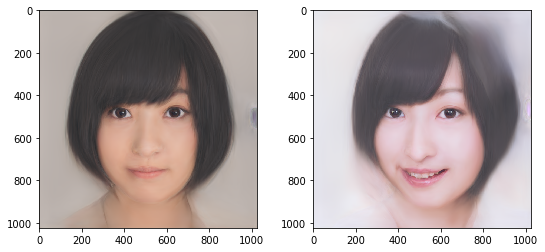

Target W+ output


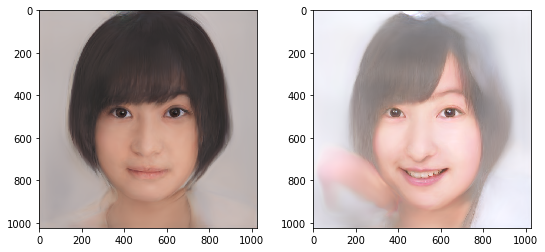

Epoch:  150
Batch:  1
This batch:  ['3_rest_01', '2_staring_01']
Total time elapsed:  239.7173366546631  s
W+ loss:  3499.3623046875
Feature loss:  34.98225784301758  | Pixel loss:  0.029239526018500328  | Target prop loss:  0.03968193754553795
Weighted - Feature loss:  3498.225784301758  | Pixel loss:  2.923952601850033  | Target prop loss:  396.8193754553795
Total loss:  3897.96923828125


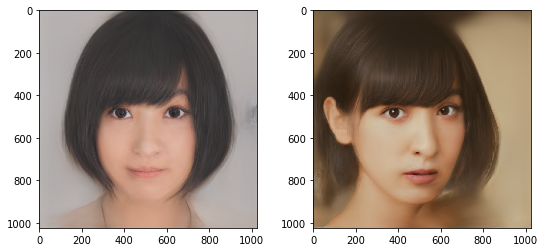

Target W+ output


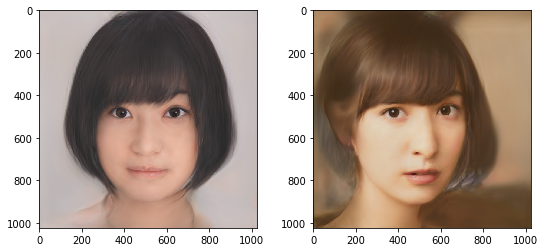

Epoch:  150
Batch:  2
This batch:  ['1_rightstare_01', '4_hmm_01']
Total time elapsed:  241.03521466255188  s
W+ loss:  4295.2822265625
Feature loss:  34.86788558959961  | Pixel loss:  0.019120274111628532  | Target prop loss:  0.04509114846587181
Weighted - Feature loss:  3486.788558959961  | Pixel loss:  1.9120274111628532  | Target prop loss:  450.9114846587181
Total loss:  3939.6123046875


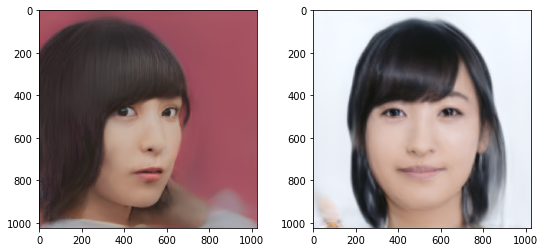

Target W+ output


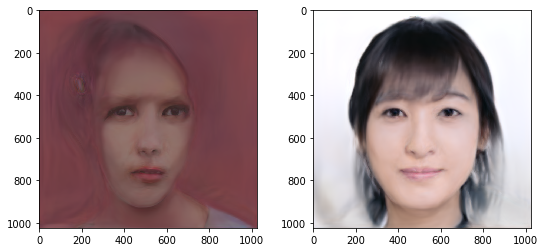

Epoch:  150
Batch:  3
This batch:  ['5_smiling_01', '6_straight_01']
Total time elapsed:  242.39940547943115  s
W+ loss:  5500.14013671875
Feature loss:  56.60895919799805  | Pixel loss:  0.02749464102089405  | Target prop loss:  0.04835670068860054
Weighted - Feature loss:  5660.895919799805  | Pixel loss:  2.749464102089405  | Target prop loss:  483.5670068860054
Total loss:  6147.21240234375


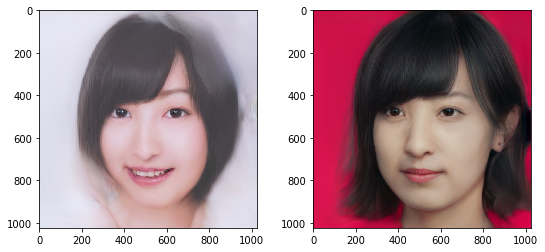

Target W+ output


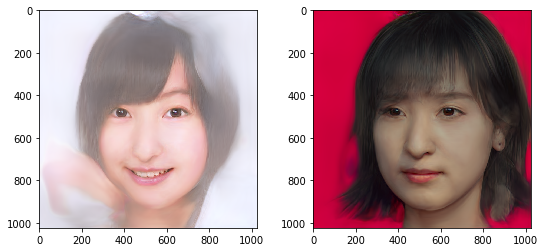

Epoch:  175
Batch:  1
This batch:  ['5_smiling_01', '1_rightstare_01']
Total time elapsed:  279.9578218460083  s
W+ loss:  4358.05810546875
Feature loss:  43.18537521362305  | Pixel loss:  0.03529032692313194  | Target prop loss:  0.054197583347558975
Weighted - Feature loss:  4318.537521362305  | Pixel loss:  3.5290326923131943  | Target prop loss:  541.9758334755898
Total loss:  4864.0419921875


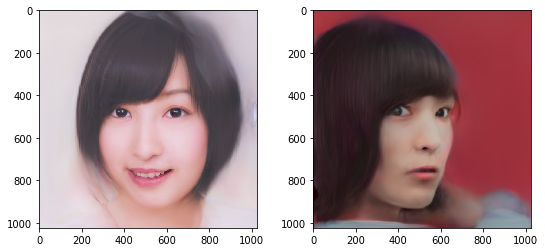

Target W+ output


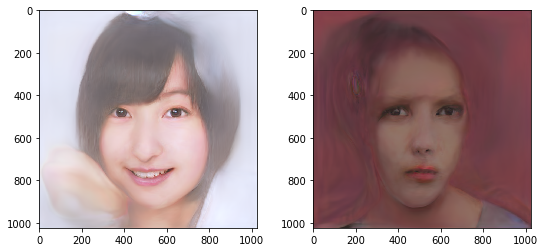

Epoch:  175
Batch:  2
This batch:  ['4_hmm_01', '3_rest_01']
Total time elapsed:  281.2572638988495  s
W+ loss:  2702.969482421875
Feature loss:  29.83974266052246  | Pixel loss:  0.013327482156455517  | Target prop loss:  0.04082537069916725
Weighted - Feature loss:  2983.974266052246  | Pixel loss:  1.3327482156455517  | Target prop loss:  408.2537069916725
Total loss:  3393.560791015625


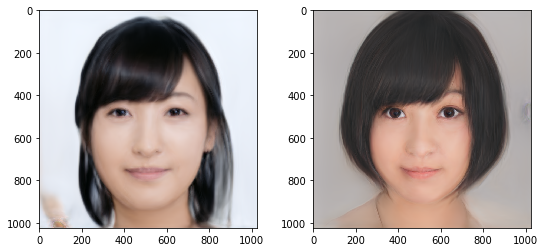

Target W+ output


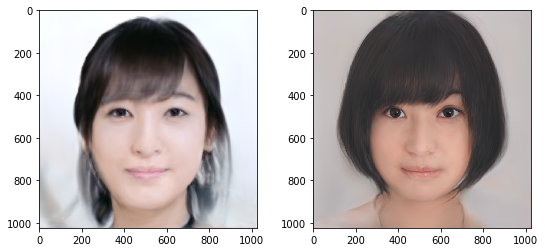

Epoch:  175
Batch:  3
This batch:  ['2_staring_01', '6_straight_01']
Total time elapsed:  282.56075143814087  s
W+ loss:  5417.87158203125
Feature loss:  61.15497589111328  | Pixel loss:  0.03273117542266846  | Target prop loss:  0.055234137922525406
Weighted - Feature loss:  6115.497589111328  | Pixel loss:  3.2731175422668457  | Target prop loss:  552.3413792252541
Total loss:  6671.11181640625


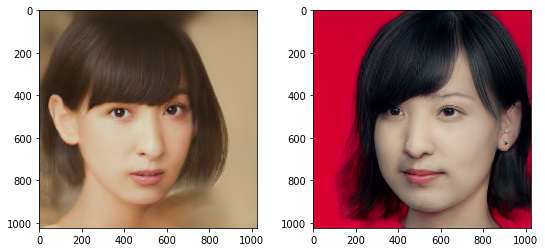

Target W+ output


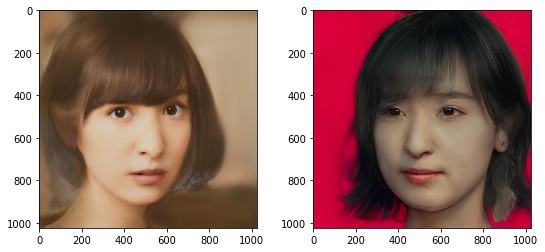

Epoch:  200
Batch:  1
This batch:  ['3_rest_01', '4_hmm_01']
Total time elapsed:  319.99676847457886  s
W+ loss:  2580.39404296875
Feature loss:  27.44190216064453  | Pixel loss:  0.011413796804845333  | Target prop loss:  0.04338408634066582
Weighted - Feature loss:  2744.190216064453  | Pixel loss:  1.1413796804845333  | Target prop loss:  433.8408634066582
Total loss:  3179.17236328125


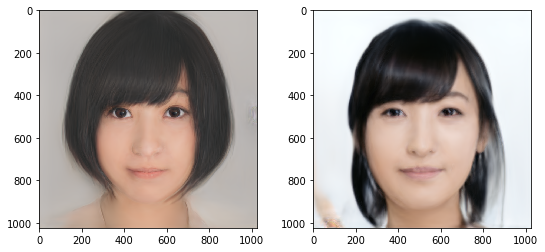

Target W+ output


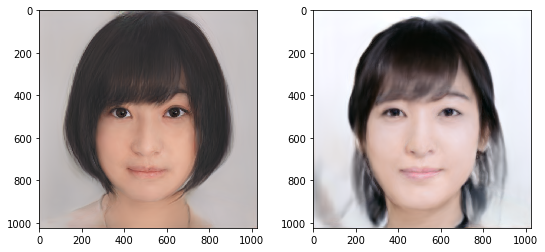

Epoch:  200
Batch:  2
This batch:  ['5_smiling_01', '6_straight_01']
Total time elapsed:  321.29066610336304  s
W+ loss:  5025.19140625
Feature loss:  50.24556350708008  | Pixel loss:  0.020239299163222313  | Target prop loss:  0.05652887374162674
Weighted - Feature loss:  5024.556350708008  | Pixel loss:  2.0239299163222313  | Target prop loss:  565.2887374162674
Total loss:  5591.86865234375


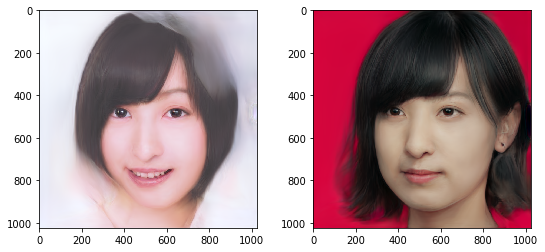

Target W+ output


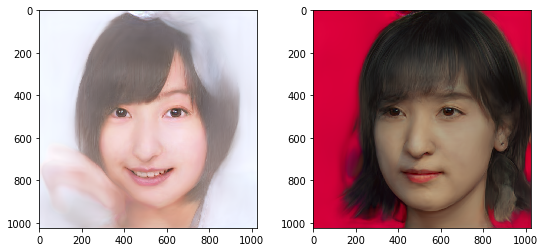

Epoch:  200
Batch:  3
This batch:  ['2_staring_01', '1_rightstare_01']
Total time elapsed:  322.6453731060028  s
W+ loss:  4921.16162109375
Feature loss:  42.674171447753906  | Pixel loss:  0.03253505751490593  | Target prop loss:  0.04860033467411995
Weighted - Feature loss:  4267.417144775391  | Pixel loss:  3.253505751490593  | Target prop loss:  486.0033467411995
Total loss:  4756.673828125


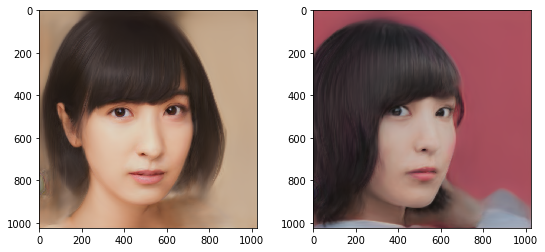

Target W+ output


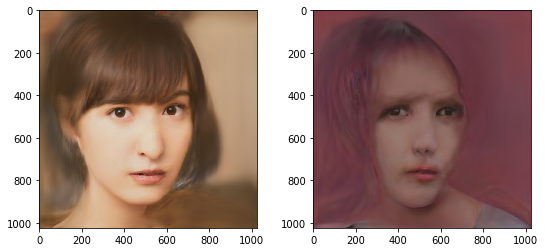

Cycle:  2 LR:  0.001
Epoch:  1
Batch:  1
This batch:  ['1_rightstare_01', '4_hmm_01']
Total time elapsed:  0.5108990669250488  s
W+ loss:  3846.31982421875
Feature loss:  32.545108795166016  | Pixel loss:  0.01940298266708851  | Target prop loss:  0.050063591450452805
Weighted - Feature loss:  3254.5108795166016  | Pixel loss:  1.9402982667088509  | Target prop loss:  500.63591450452805
Total loss:  3757.087158203125


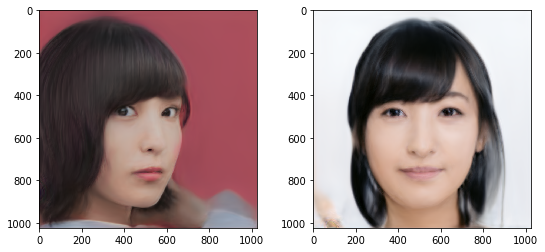

Target W+ output


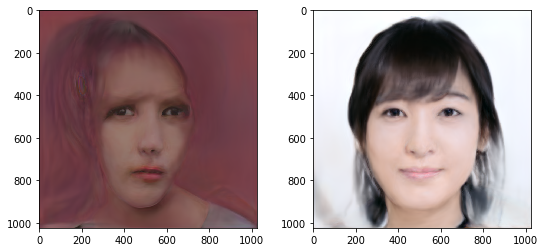

Epoch:  1
Batch:  2
This batch:  ['6_straight_01', '5_smiling_01']
Total time elapsed:  1.7957966327667236  s
W+ loss:  4851.12451171875
Feature loss:  49.21946334838867  | Pixel loss:  0.02187756448984146  | Target prop loss:  0.05722958594560623
Weighted - Feature loss:  4921.946334838867  | Pixel loss:  2.187756448984146  | Target prop loss:  572.2958594560623
Total loss:  5496.43017578125


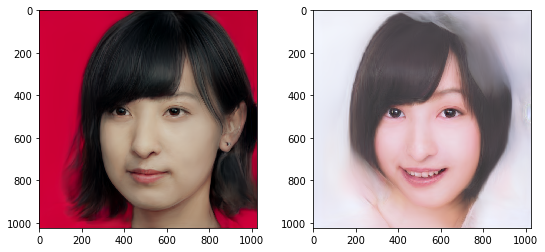

Target W+ output


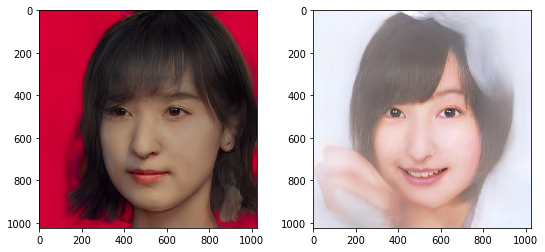

Epoch:  1
Batch:  3
This batch:  ['3_rest_01', '2_staring_01']
Total time elapsed:  3.135833263397217  s
W+ loss:  3718.42236328125
Feature loss:  37.558536529541016  | Pixel loss:  0.02638385258615017  | Target prop loss:  0.04040180891752243
Weighted - Feature loss:  3755.8536529541016  | Pixel loss:  2.638385258615017  | Target prop loss:  404.0180891752243
Total loss:  4162.51025390625


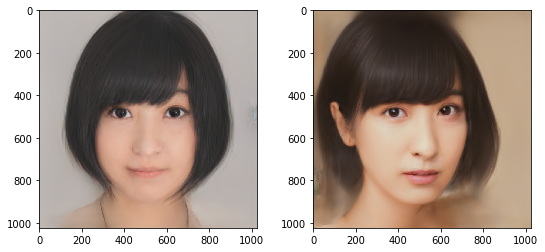

Target W+ output


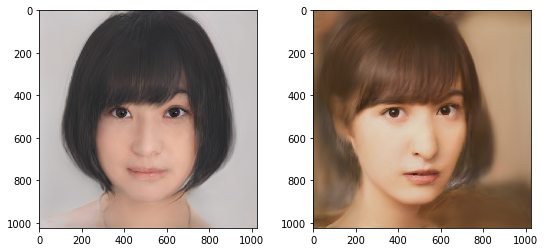

Epoch:  25
Batch:  1
This batch:  ['2_staring_01', '4_hmm_01']
Total time elapsed:  38.91491961479187  s
W+ loss:  3315.08740234375
Feature loss:  31.541282653808594  | Pixel loss:  0.020359745249152184  | Target prop loss:  0.046641960740089417
Weighted - Feature loss:  3154.1282653808594  | Pixel loss:  2.0359745249152184  | Target prop loss:  466.41960740089417
Total loss:  3622.583740234375


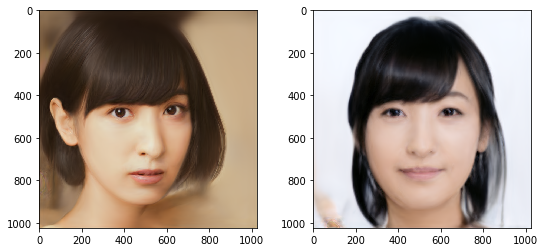

Target W+ output


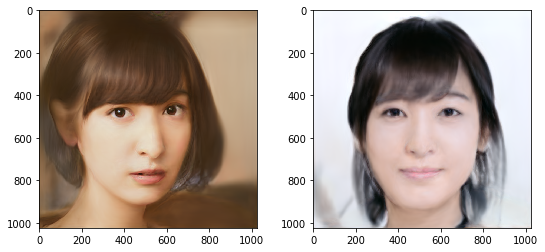

Epoch:  25
Batch:  2
This batch:  ['5_smiling_01', '3_rest_01']
Total time elapsed:  40.22919249534607  s
W+ loss:  2463.419677734375
Feature loss:  26.775867462158203  | Pixel loss:  0.012118124403059483  | Target prop loss:  0.04435291513800621
Weighted - Feature loss:  2677.5867462158203  | Pixel loss:  1.2118124403059483  | Target prop loss:  443.5291513800621
Total loss:  3122.32763671875


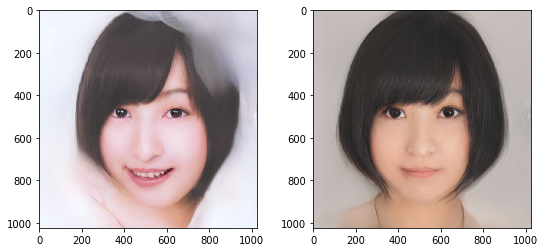

Target W+ output


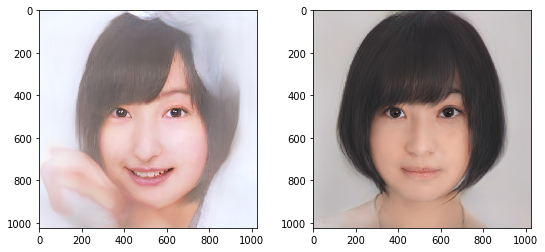

Epoch:  25
Batch:  3
This batch:  ['6_straight_01', '1_rightstare_01']
Total time elapsed:  41.539557456970215  s
W+ loss:  4710.64892578125
Feature loss:  38.161277770996094  | Pixel loss:  0.01951744221150875  | Target prop loss:  0.05624745413661003
Weighted - Feature loss:  3816.1277770996094  | Pixel loss:  1.951744221150875  | Target prop loss:  562.4745413661003
Total loss:  4380.5537109375


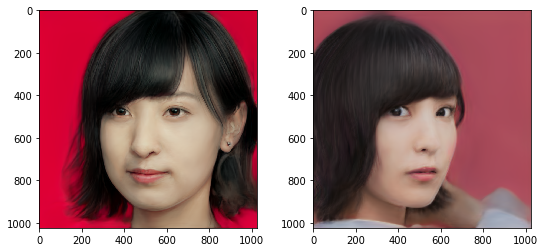

Target W+ output


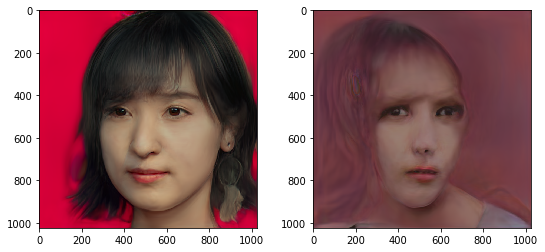

Epoch:  50
Batch:  1
This batch:  ['5_smiling_01', '6_straight_01']
Total time elapsed:  79.13554167747498  s
W+ loss:  4171.0087890625
Feature loss:  42.19093322753906  | Pixel loss:  0.016825983300805092  | Target prop loss:  0.05613286793231964
Weighted - Feature loss:  4219.093322753906  | Pixel loss:  1.6825983300805092  | Target prop loss:  561.3286793231964
Total loss:  4782.1044921875


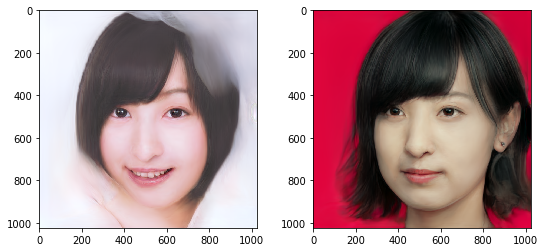

Target W+ output


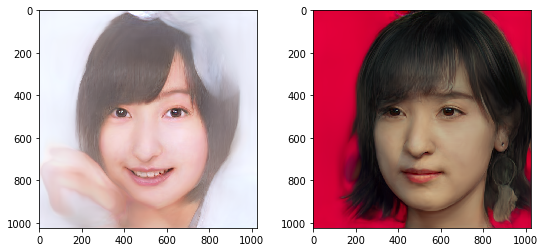

Epoch:  50
Batch:  2
This batch:  ['2_staring_01', '3_rest_01']
Total time elapsed:  80.4491217136383  s
W+ loss:  2697.573486328125
Feature loss:  27.04589080810547  | Pixel loss:  0.019382571801543236  | Target prop loss:  0.04191156104207039
Weighted - Feature loss:  2704.589080810547  | Pixel loss:  1.9382571801543236  | Target prop loss:  419.1156104207039
Total loss:  3125.64306640625


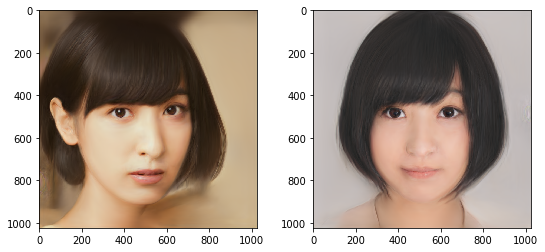

Target W+ output


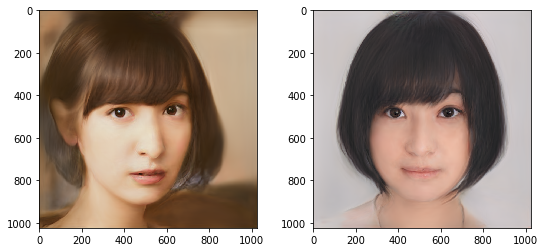

Epoch:  50
Batch:  3
This batch:  ['1_rightstare_01', '4_hmm_01']
Total time elapsed:  81.81548857688904  s
W+ loss:  3387.6123046875
Feature loss:  24.900455474853516  | Pixel loss:  0.012460723519325256  | Target prop loss:  0.04840292036533356
Weighted - Feature loss:  2490.0455474853516  | Pixel loss:  1.2460723519325256  | Target prop loss:  484.02920365333557
Total loss:  2975.321044921875


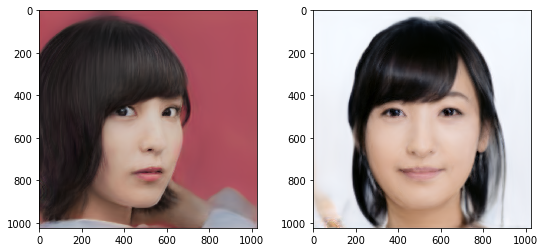

Target W+ output


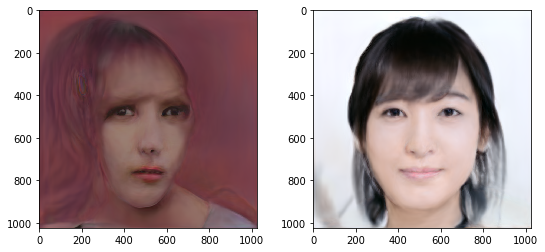

Epoch:  75
Batch:  1
This batch:  ['3_rest_01', '5_smiling_01']
Total time elapsed:  119.06590723991394  s
W+ loss:  2371.936279296875
Feature loss:  25.65657615661621  | Pixel loss:  0.01101706549525261  | Target prop loss:  0.04405072331428528
Weighted - Feature loss:  2565.657615661621  | Pixel loss:  1.101706549525261  | Target prop loss:  440.5072331428528
Total loss:  3007.266845703125


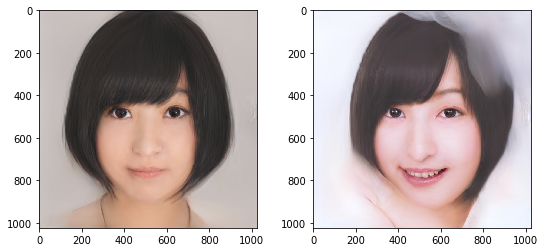

Target W+ output


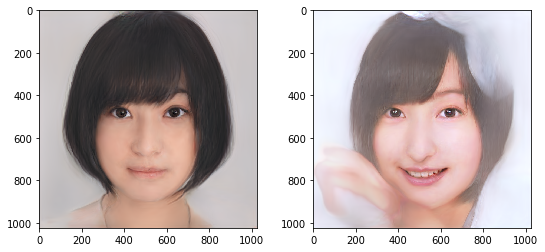

Epoch:  75
Batch:  2
This batch:  ['2_staring_01', '1_rightstare_01']
Total time elapsed:  120.36091232299805  s
W+ loss:  3717.02783203125
Feature loss:  28.872116088867188  | Pixel loss:  0.02359789051115513  | Target prop loss:  0.048375219106674194
Weighted - Feature loss:  2887.2116088867188  | Pixel loss:  2.359789051115513  | Target prop loss:  483.75219106674194
Total loss:  3373.32373046875


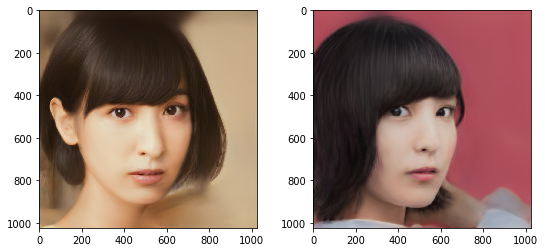

Target W+ output


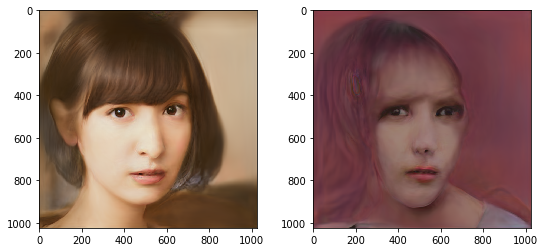

Epoch:  75
Batch:  3
This batch:  ['4_hmm_01', '6_straight_01']
Total time elapsed:  121.66284370422363  s
W+ loss:  3956.76806640625
Feature loss:  36.331153869628906  | Pixel loss:  0.01306317001581192  | Target prop loss:  0.05500408262014389
Weighted - Feature loss:  3633.1153869628906  | Pixel loss:  1.306317001581192  | Target prop loss:  550.0408262014389
Total loss:  4184.462890625


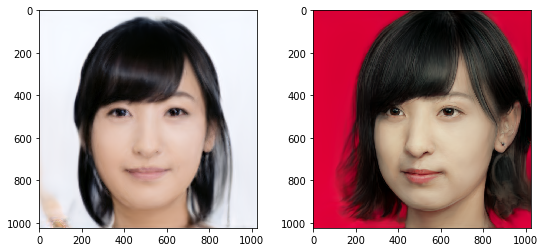

Target W+ output


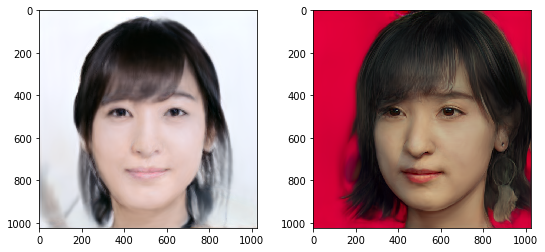

Epoch:  100
Batch:  1
This batch:  ['1_rightstare_01', '6_straight_01']
Total time elapsed:  159.02427220344543  s
W+ loss:  4467.1708984375
Feature loss:  34.8630256652832  | Pixel loss:  0.015876716002821922  | Target prop loss:  0.0564684197306633
Weighted - Feature loss:  3486.3025665283203  | Pixel loss:  1.5876716002821922  | Target prop loss:  564.684197306633
Total loss:  4052.57421875


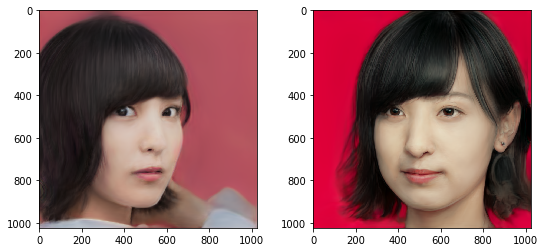

Target W+ output


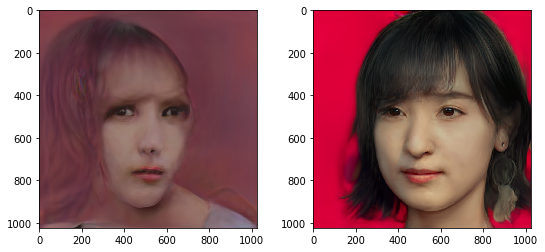

Epoch:  100
Batch:  2
This batch:  ['3_rest_01', '5_smiling_01']
Total time elapsed:  160.31613421440125  s
W+ loss:  2335.784423828125
Feature loss:  25.164302825927734  | Pixel loss:  0.010247659869492054  | Target prop loss:  0.044387005269527435
Weighted - Feature loss:  2516.4302825927734  | Pixel loss:  1.0247659869492054  | Target prop loss:  443.87005269527435
Total loss:  2961.324951171875


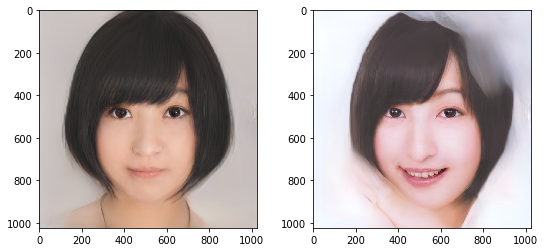

Target W+ output


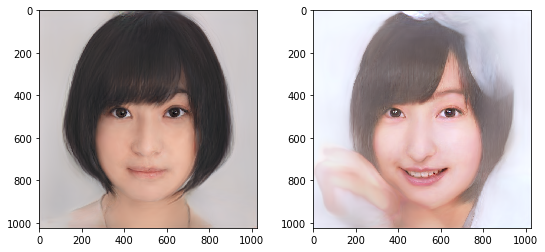

Epoch:  100
Batch:  3
This batch:  ['4_hmm_01', '2_staring_01']
Total time elapsed:  161.68739867210388  s
W+ loss:  3104.424560546875
Feature loss:  29.460086822509766  | Pixel loss:  0.019442839547991753  | Target prop loss:  0.04679468274116516
Weighted - Feature loss:  2946.0086822509766  | Pixel loss:  1.9442839547991753  | Target prop loss:  467.9468274116516
Total loss:  3415.89990234375


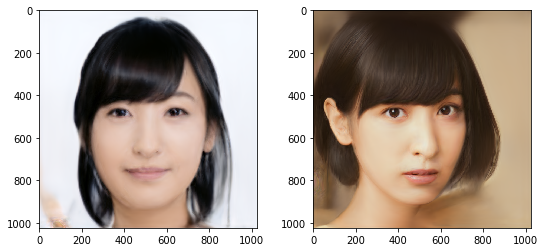

Target W+ output


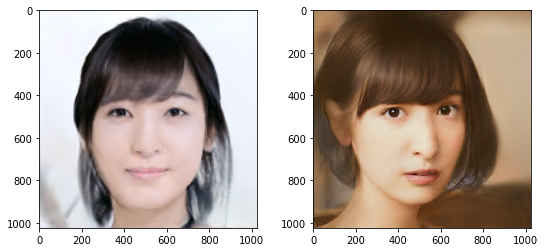

Epoch:  125
Batch:  1
This batch:  ['3_rest_01', '1_rightstare_01']
Total time elapsed:  199.244131565094  s
W+ loss:  2726.591552734375
Feature loss:  21.12449073791504  | Pixel loss:  0.01024209801107645  | Target prop loss:  0.04435872286558151
Weighted - Feature loss:  2112.449073791504  | Pixel loss:  1.024209801107645  | Target prop loss:  443.5872286558151
Total loss:  2557.060302734375


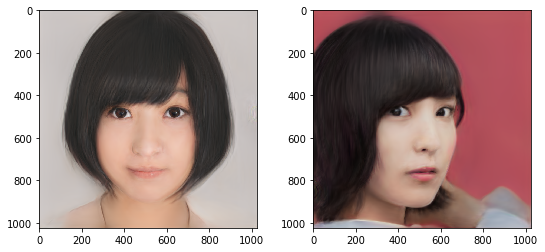

Target W+ output


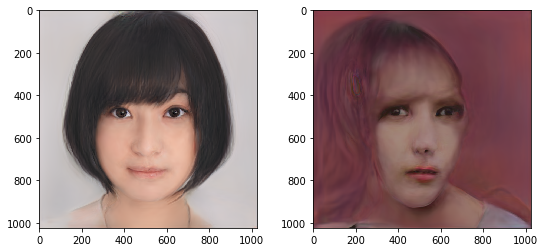

Epoch:  125
Batch:  2
This batch:  ['6_straight_01', '5_smiling_01']
Total time elapsed:  200.52670240402222  s
W+ loss:  4023.666748046875
Feature loss:  39.49830627441406  | Pixel loss:  0.015651745721697807  | Target prop loss:  0.0573350265622139
Weighted - Feature loss:  3949.8306274414062  | Pixel loss:  1.5651745721697807  | Target prop loss:  573.350265622139
Total loss:  4524.74609375


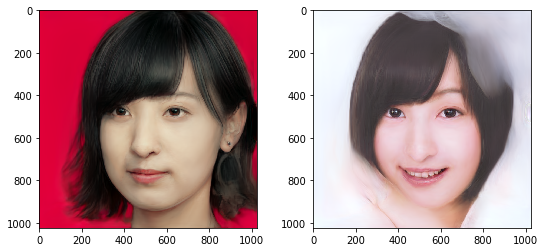

Target W+ output


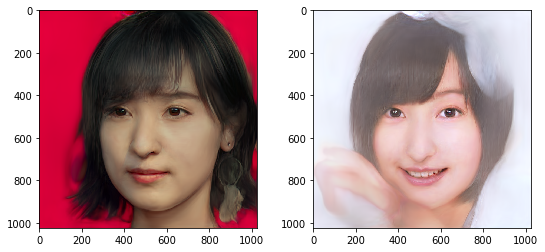

Epoch:  125
Batch:  3
This batch:  ['4_hmm_01', '2_staring_01']
Total time elapsed:  201.8335461616516  s
W+ loss:  3211.983642578125
Feature loss:  29.385766983032227  | Pixel loss:  0.019387410953640938  | Target prop loss:  0.04732896760106087
Weighted - Feature loss:  2938.5766983032227  | Pixel loss:  1.9387410953640938  | Target prop loss:  473.2896760106087
Total loss:  3413.80517578125


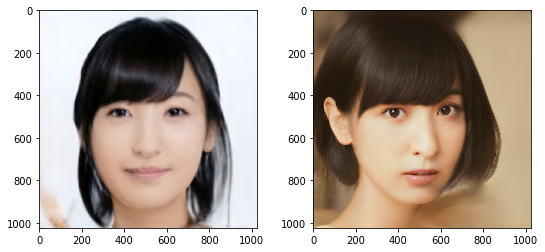

Target W+ output


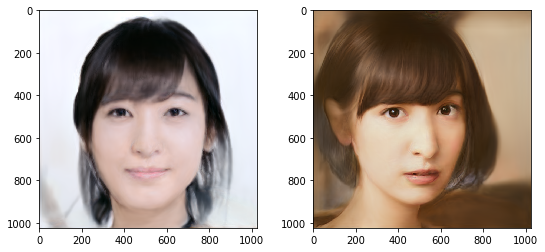

Epoch:  150
Batch:  1
This batch:  ['1_rightstare_01', '2_staring_01']
Total time elapsed:  239.4895715713501  s
W+ loss:  3581.03076171875
Feature loss:  27.557964324951172  | Pixel loss:  0.02273334003984928  | Target prop loss:  0.048552125692367554
Weighted - Feature loss:  2755.796432495117  | Pixel loss:  2.273334003984928  | Target prop loss:  485.52125692367554
Total loss:  3243.591064453125


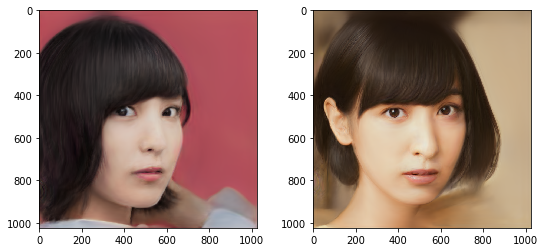

Target W+ output


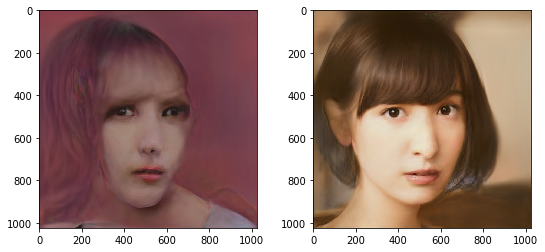

Epoch:  150
Batch:  2
This batch:  ['6_straight_01', '5_smiling_01']
Total time elapsed:  240.80875515937805  s
W+ loss:  3946.41796875
Feature loss:  37.74367141723633  | Pixel loss:  0.015755116939544678  | Target prop loss:  0.05742128565907478
Weighted - Feature loss:  3774.367141723633  | Pixel loss:  1.5755116939544678  | Target prop loss:  574.2128565907478
Total loss:  4350.1552734375


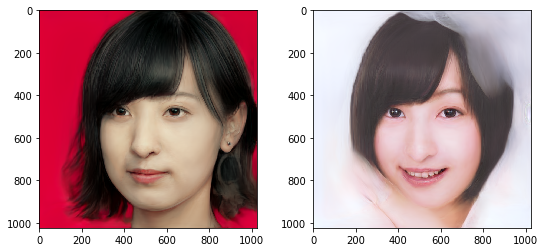

Target W+ output


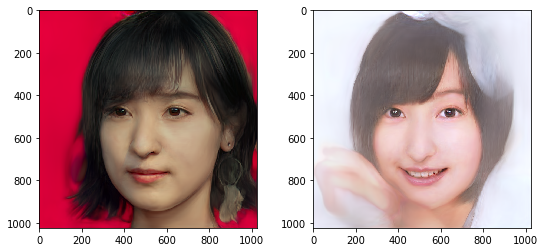

Epoch:  150
Batch:  3
This batch:  ['3_rest_01', '4_hmm_01']
Total time elapsed:  242.18229937553406  s
W+ loss:  2148.55517578125
Feature loss:  20.801074981689453  | Pixel loss:  0.0073257493786513805  | Target prop loss:  0.04223630204796791
Weighted - Feature loss:  2080.1074981689453  | Pixel loss:  0.732574937865138  | Target prop loss:  422.3630204796791
Total loss:  2503.203125


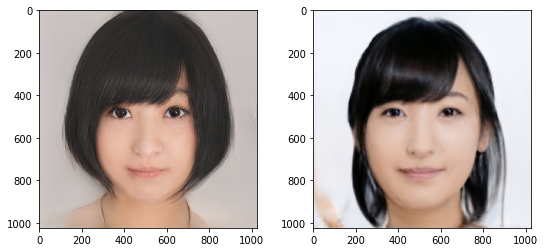

Target W+ output


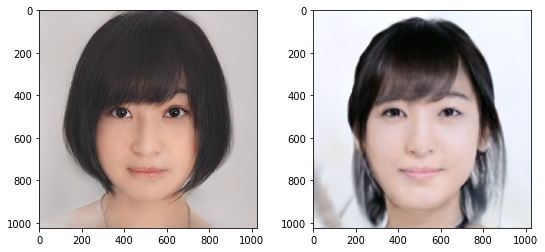

Epoch:  175
Batch:  1
This batch:  ['2_staring_01', '5_smiling_01']
Total time elapsed:  279.7746319770813  s
W+ loss:  3203.915771484375
Feature loss:  32.46418762207031  | Pixel loss:  0.022225482389330864  | Target prop loss:  0.049517080187797546
Weighted - Feature loss:  3246.4187622070312  | Pixel loss:  2.2225482389330864  | Target prop loss:  495.17080187797546
Total loss:  3743.812255859375


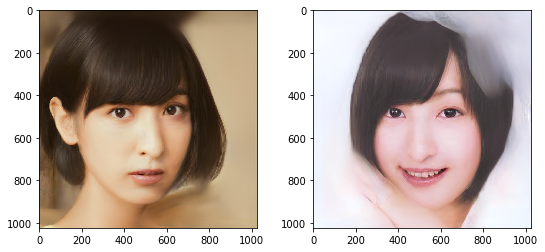

Target W+ output


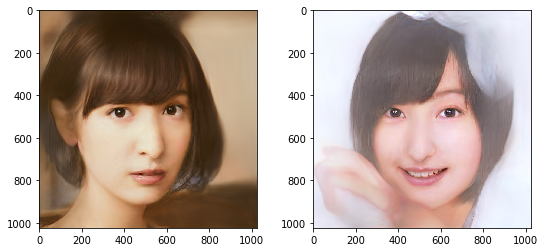

Epoch:  175
Batch:  2
This batch:  ['4_hmm_01', '6_straight_01']
Total time elapsed:  281.0770492553711  s
W+ loss:  3807.192138671875
Feature loss:  34.364105224609375  | Pixel loss:  0.012675669975578785  | Target prop loss:  0.05571436136960983
Weighted - Feature loss:  3436.4105224609375  | Pixel loss:  1.2675669975578785  | Target prop loss:  557.1436136960983
Total loss:  3994.82177734375


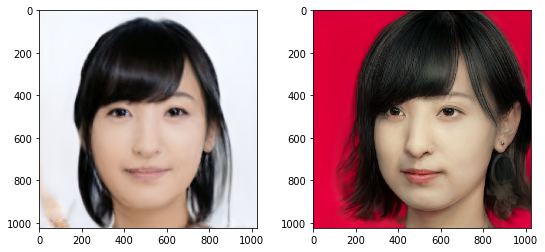

Target W+ output


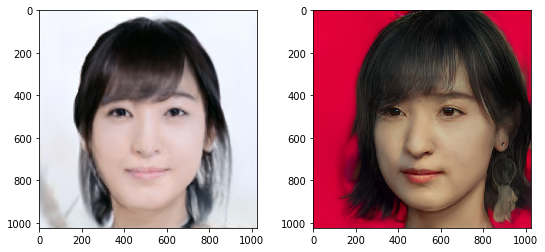

Epoch:  175
Batch:  3
This batch:  ['3_rest_01', '1_rightstare_01']
Total time elapsed:  282.38248443603516  s
W+ loss:  2670.1650390625
Feature loss:  19.812419891357422  | Pixel loss:  0.010379116050899029  | Target prop loss:  0.0440225750207901
Weighted - Feature loss:  1981.2419891357422  | Pixel loss:  1.0379116050899029  | Target prop loss:  440.225750207901
Total loss:  2422.505615234375


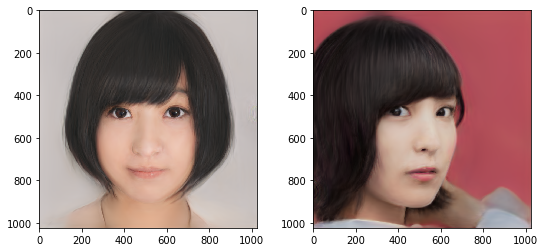

Target W+ output


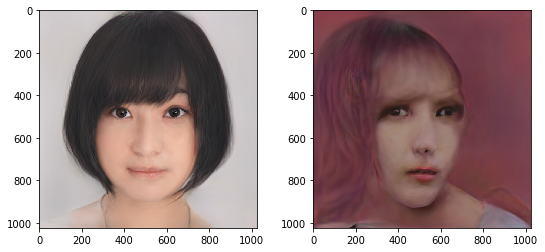

Epoch:  200
Batch:  1
This batch:  ['4_hmm_01', '1_rightstare_01']
Total time elapsed:  320.033988237381  s
W+ loss:  3142.008056640625
Feature loss:  22.670738220214844  | Pixel loss:  0.01170751079916954  | Target prop loss:  0.04938652738928795
Weighted - Feature loss:  2267.0738220214844  | Pixel loss:  1.170751079916954  | Target prop loss:  493.8652738928795
Total loss:  2762.109619140625


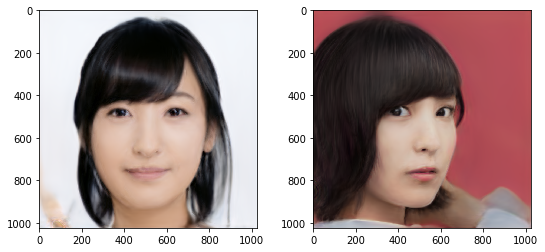

Target W+ output


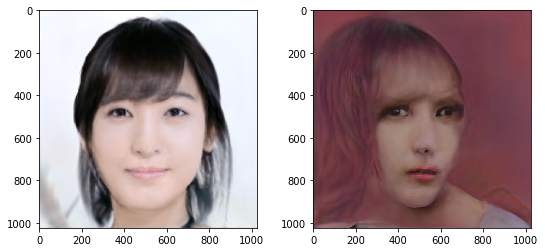

Epoch:  200
Batch:  2
This batch:  ['3_rest_01', '2_staring_01']
Total time elapsed:  321.3458971977234  s
W+ loss:  2516.141845703125
Feature loss:  26.380115509033203  | Pixel loss:  0.01916441321372986  | Target prop loss:  0.042690832167863846
Weighted - Feature loss:  2638.0115509033203  | Pixel loss:  1.9164413213729858  | Target prop loss:  426.90832167863846
Total loss:  3066.83642578125


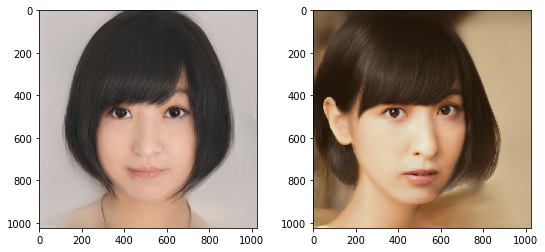

Target W+ output


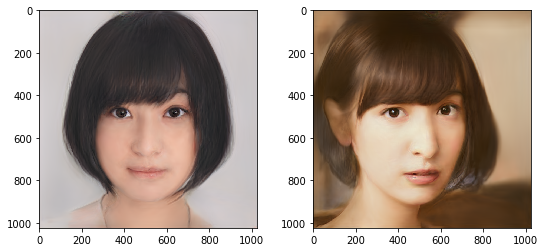

Epoch:  200
Batch:  3
This batch:  ['5_smiling_01', '6_straight_01']
Total time elapsed:  322.7139003276825  s
W+ loss:  3929.42724609375
Feature loss:  38.63360595703125  | Pixel loss:  0.01605003885924816  | Target prop loss:  0.05805644765496254
Weighted - Feature loss:  3863.360595703125  | Pixel loss:  1.6050038859248161  | Target prop loss:  580.5644765496254
Total loss:  4445.5302734375


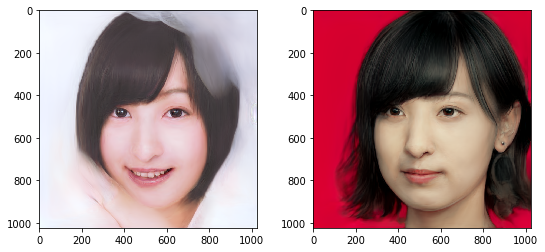

Target W+ output


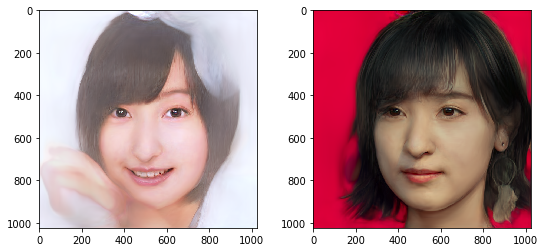

Fine tuning with higher pixel loss...
Epoch:  1
Batch:  1
This batch:  ['5_smiling_01', '1_rightstare_01']
Total time elapsed:  0.5115776062011719  s
W+ loss:  3753.139892578125
Feature loss:  26.4556884765625  | Pixel loss:  0.013880371116101742  | Target prop loss:  0.050985220819711685
Weighted - Feature loss:  2645.56884765625  | Pixel loss:  138.80371116101742  | Target prop loss:  509.85220819711685
Total loss:  3294.224853515625


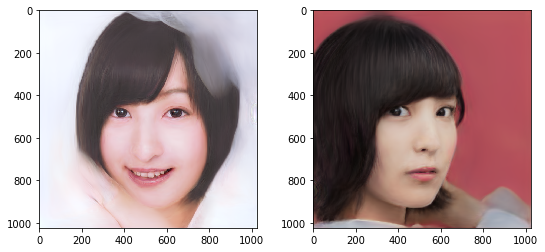

Target W+ output


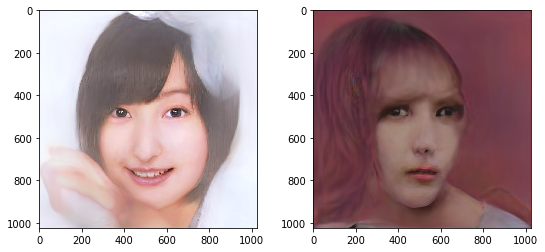

Epoch:  1
Batch:  2
This batch:  ['2_staring_01', '6_straight_01']
Total time elapsed:  1.8083889484405518  s
W+ loss:  4434.8095703125
Feature loss:  39.2744255065918  | Pixel loss:  0.02441907487809658  | Target prop loss:  0.05584387108683586
Weighted - Feature loss:  3927.4425506591797  | Pixel loss:  244.1907487809658  | Target prop loss:  558.4387108683586
Total loss:  4730.072265625


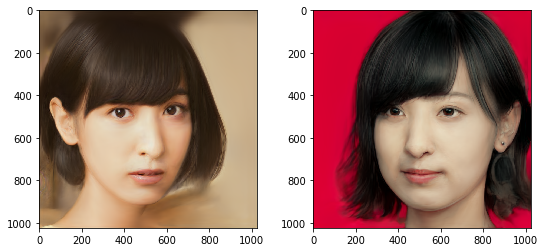

Target W+ output


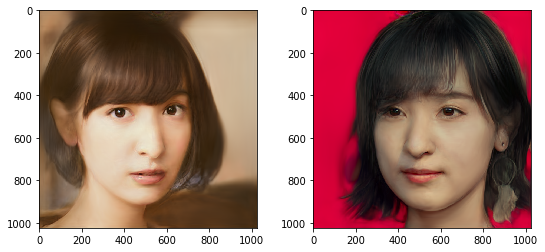

Epoch:  1
Batch:  3
This batch:  ['3_rest_01', '4_hmm_01']
Total time elapsed:  3.1507511138916016  s
W+ loss:  2202.01220703125
Feature loss:  20.865076065063477  | Pixel loss:  0.00748199038207531  | Target prop loss:  0.042351577430963516
Weighted - Feature loss:  2086.5076065063477  | Pixel loss:  74.8199038207531  | Target prop loss:  423.51577430963516
Total loss:  2584.84326171875


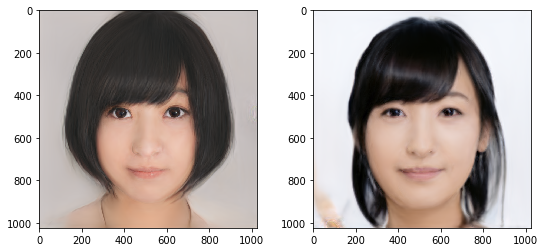

Target W+ output


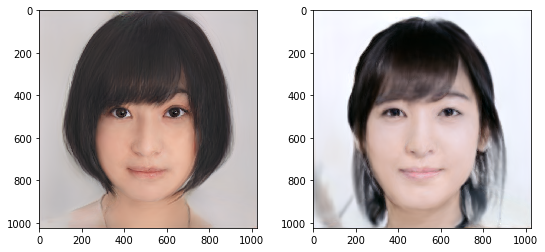

Epoch:  25
Batch:  1
This batch:  ['4_hmm_01', '3_rest_01']
Total time elapsed:  39.18940305709839  s
W+ loss:  2168.669677734375
Feature loss:  20.080984115600586  | Pixel loss:  0.006066282745450735  | Target prop loss:  0.04243595153093338
Weighted - Feature loss:  2008.0984115600586  | Pixel loss:  60.66282745450735  | Target prop loss:  424.3595153093338
Total loss:  2493.120849609375


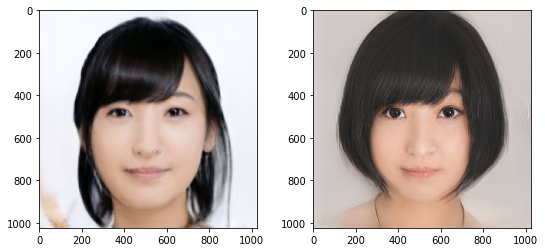

Target W+ output


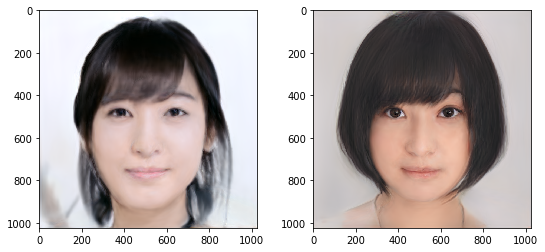

Epoch:  25
Batch:  2
This batch:  ['1_rightstare_01', '5_smiling_01']
Total time elapsed:  40.4823534488678  s
W+ loss:  3683.75048828125
Feature loss:  25.245235443115234  | Pixel loss:  0.010970172472298145  | Target prop loss:  0.05126900225877762
Weighted - Feature loss:  2524.5235443115234  | Pixel loss:  109.70172472298145  | Target prop loss:  512.6900225877762
Total loss:  3146.9150390625


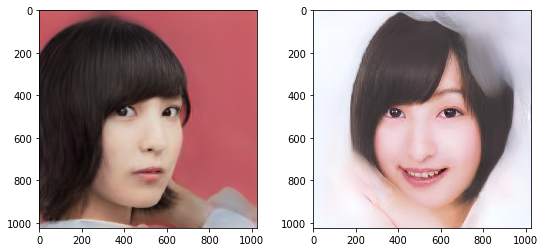

Target W+ output


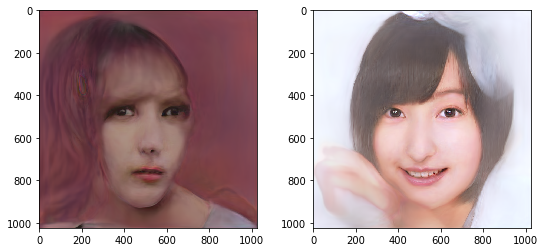

Epoch:  25
Batch:  3
This batch:  ['6_straight_01', '2_staring_01']
Total time elapsed:  41.811559200286865  s
W+ loss:  4332.6533203125
Feature loss:  37.63463592529297  | Pixel loss:  0.021436205133795738  | Target prop loss:  0.05544114485383034
Weighted - Feature loss:  3763.463592529297  | Pixel loss:  214.36205133795738  | Target prop loss:  554.4114485383034
Total loss:  4532.2373046875


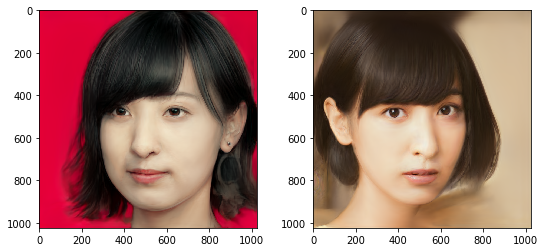

Target W+ output


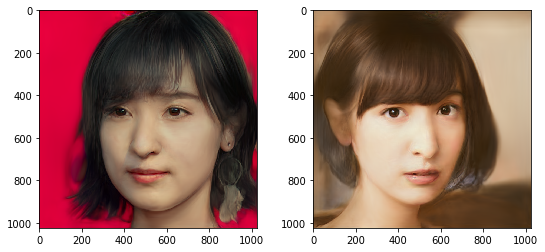

Epoch:  50
Batch:  1
This batch:  ['5_smiling_01', '1_rightstare_01']
Total time elapsed:  79.38496685028076  s
W+ loss:  3663.759033203125
Feature loss:  25.14698600769043  | Pixel loss:  0.010199160315096378  | Target prop loss:  0.05131231248378754
Weighted - Feature loss:  2514.698600769043  | Pixel loss:  101.99160315096378  | Target prop loss:  513.1231248378754
Total loss:  3129.813232421875


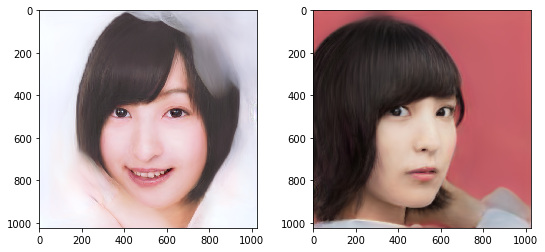

Target W+ output


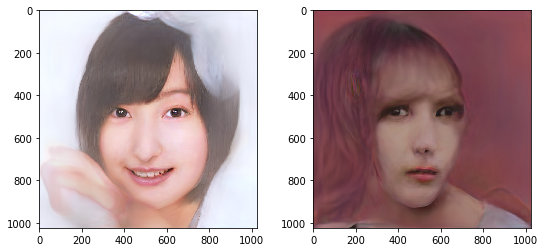

Epoch:  50
Batch:  2
This batch:  ['2_staring_01', '4_hmm_01']
Total time elapsed:  80.68337845802307  s
W+ loss:  3095.53564453125
Feature loss:  27.543581008911133  | Pixel loss:  0.017148075625300407  | Target prop loss:  0.047308072447776794
Weighted - Feature loss:  2754.3581008911133  | Pixel loss:  171.48075625300407  | Target prop loss:  473.08072447776794
Total loss:  3398.919677734375


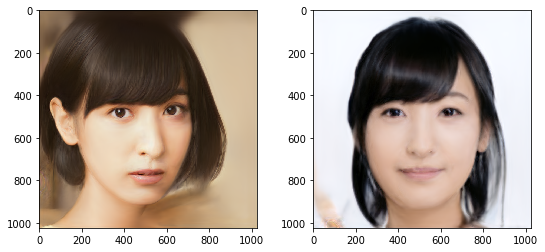

Target W+ output


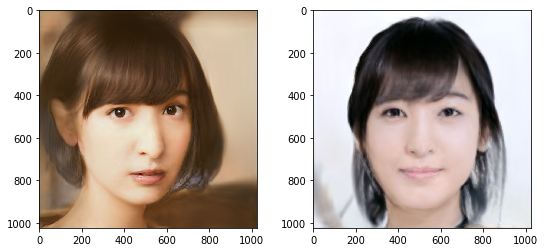

Epoch:  50
Batch:  3
This batch:  ['3_rest_01', '6_straight_01']
Total time elapsed:  82.03166151046753  s
W+ loss:  3370.751220703125
Feature loss:  29.89890480041504  | Pixel loss:  0.00951229128986597  | Target prop loss:  0.05055234581232071
Weighted - Feature loss:  2989.890480041504  | Pixel loss:  95.1229128986597  | Target prop loss:  505.5234581232071
Total loss:  3590.53662109375


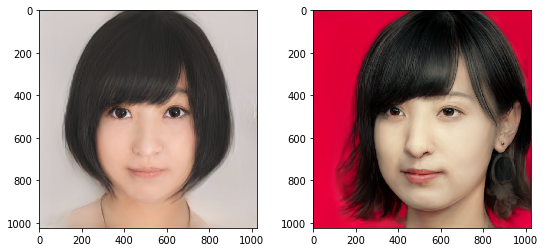

Target W+ output


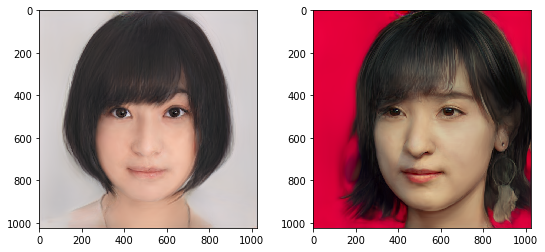

Epoch:  75
Batch:  1
This batch:  ['6_straight_01', '1_rightstare_01']
Total time elapsed:  119.66481971740723  s
W+ loss:  4663.3984375
Feature loss:  31.644268035888672  | Pixel loss:  0.010847143828868866  | Target prop loss:  0.057443611323833466
Weighted - Feature loss:  3164.426803588867  | Pixel loss:  108.47143828868866  | Target prop loss:  574.4361132383347
Total loss:  3847.334228515625


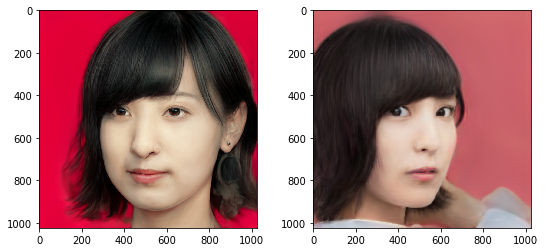

Target W+ output


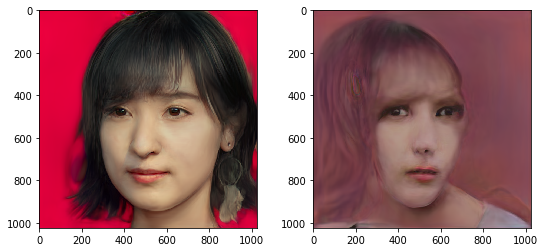

Epoch:  75
Batch:  2
This batch:  ['4_hmm_01', '5_smiling_01']
Total time elapsed:  120.97854828834534  s
W+ loss:  2871.47412109375
Feature loss:  25.997032165527344  | Pixel loss:  0.009504751302301884  | Target prop loss:  0.04967407509684563
Weighted - Feature loss:  2599.7032165527344  | Pixel loss:  95.04751302301884  | Target prop loss:  496.74075096845627
Total loss:  3191.491455078125


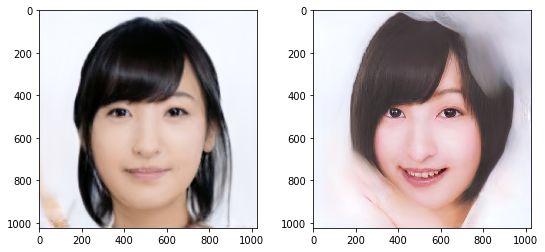

Target W+ output


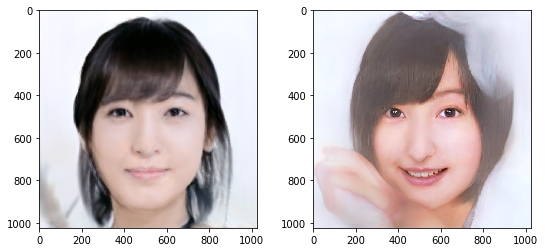

Epoch:  75
Batch:  3
This batch:  ['2_staring_01', '3_rest_01']
Total time elapsed:  122.30355834960938  s
W+ loss:  2558.039794921875
Feature loss:  24.650341033935547  | Pixel loss:  0.01573122851550579  | Target prop loss:  0.04213206097483635
Weighted - Feature loss:  2465.0341033935547  | Pixel loss:  157.3122851550579  | Target prop loss:  421.3206097483635
Total loss:  3043.6669921875


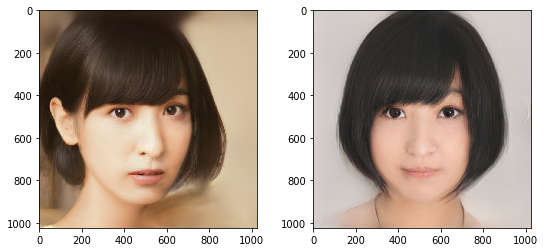

Target W+ output


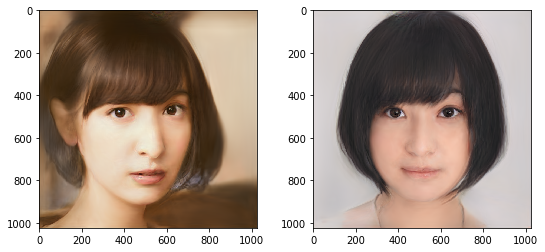

Epoch:  100
Batch:  1
This batch:  ['3_rest_01', '4_hmm_01']
Total time elapsed:  160.06449627876282  s
W+ loss:  2149.873779296875
Feature loss:  19.880962371826172  | Pixel loss:  0.00563671812415123  | Target prop loss:  0.04251604899764061
Weighted - Feature loss:  1988.0962371826172  | Pixel loss:  56.3671812415123  | Target prop loss:  425.1604899764061
Total loss:  2469.623779296875


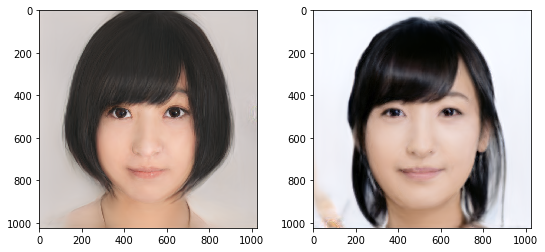

Target W+ output


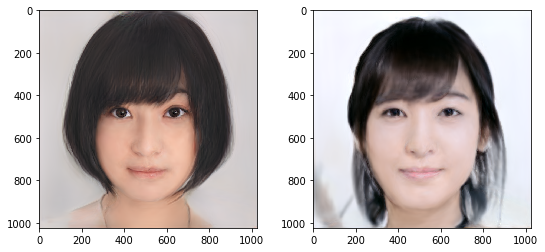

Epoch:  100
Batch:  2
This batch:  ['6_straight_01', '2_staring_01']
Total time elapsed:  161.37894821166992  s
W+ loss:  4282.5087890625
Feature loss:  37.32366180419922  | Pixel loss:  0.020314501598477364  | Target prop loss:  0.05547283962368965
Weighted - Feature loss:  3732.366180419922  | Pixel loss:  203.14501598477364  | Target prop loss:  554.7283962368965
Total loss:  4490.23974609375


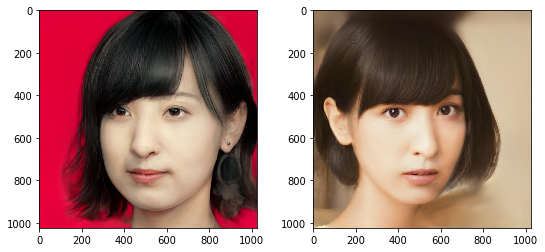

Target W+ output


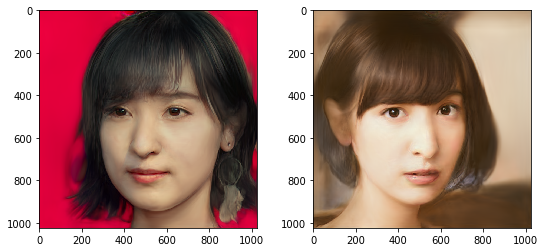

Epoch:  100
Batch:  3
This batch:  ['5_smiling_01', '1_rightstare_01']
Total time elapsed:  162.7488510608673  s
W+ loss:  3633.908203125
Feature loss:  24.999431610107422  | Pixel loss:  0.00958551187068224  | Target prop loss:  0.051431138068437576
Weighted - Feature loss:  2499.943161010742  | Pixel loss:  95.8551187068224  | Target prop loss:  514.3113806843758
Total loss:  3110.10986328125


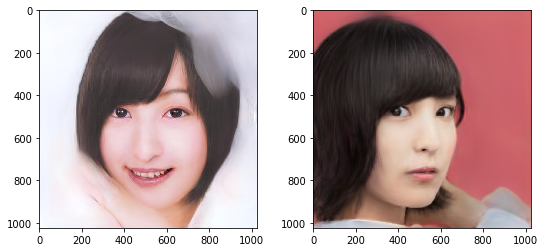

Target W+ output


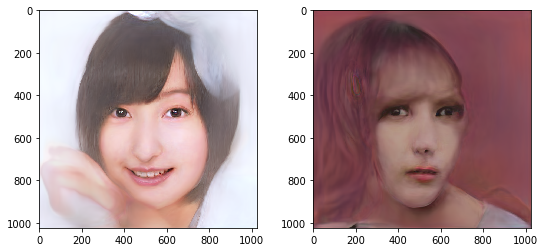

Epoch:  125
Batch:  1
This batch:  ['4_hmm_01', '6_straight_01']
Total time elapsed:  200.37167882919312  s
W+ loss:  3863.209716796875
Feature loss:  32.34728240966797  | Pixel loss:  0.010289148427546024  | Target prop loss:  0.055821359157562256
Weighted - Feature loss:  3234.728240966797  | Pixel loss:  102.89148427546024  | Target prop loss:  558.2135915756226
Total loss:  3895.83349609375


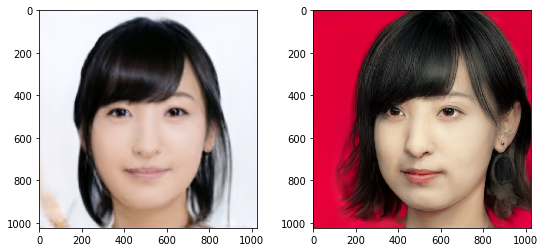

Target W+ output


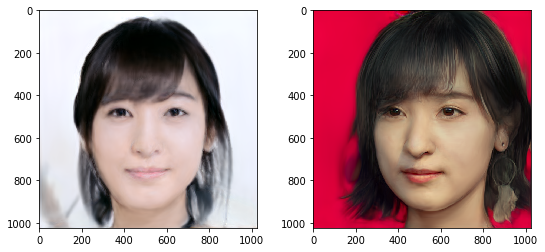

Epoch:  125
Batch:  2
This batch:  ['1_rightstare_01', '3_rest_01']
Total time elapsed:  201.67800903320312  s
W+ loss:  2911.940673828125
Feature loss:  18.897085189819336  | Pixel loss:  0.005782898515462875  | Target prop loss:  0.04423205927014351
Weighted - Feature loss:  1889.7085189819336  | Pixel loss:  57.828985154628754  | Target prop loss:  442.3205927014351
Total loss:  2389.858154296875


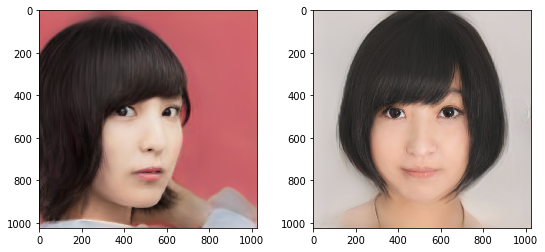

Target W+ output


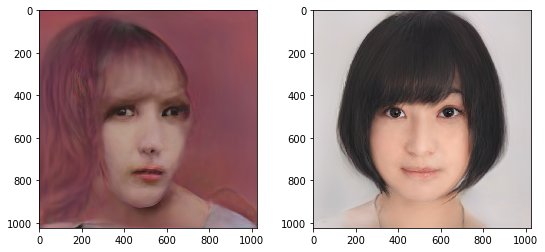

Epoch:  125
Batch:  3
This batch:  ['2_staring_01', '5_smiling_01']
Total time elapsed:  202.987806558609  s
W+ loss:  3253.99462890625
Feature loss:  30.58543586730957  | Pixel loss:  0.019106073305010796  | Target prop loss:  0.04938274994492531
Weighted - Feature loss:  3058.543586730957  | Pixel loss:  191.06073305010796  | Target prop loss:  493.8274994492531
Total loss:  3743.43212890625


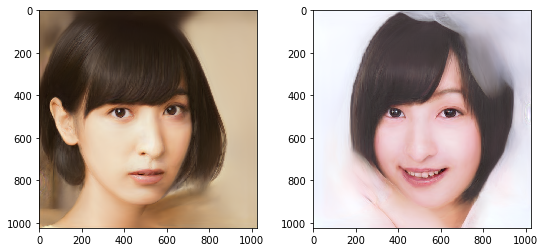

Target W+ output


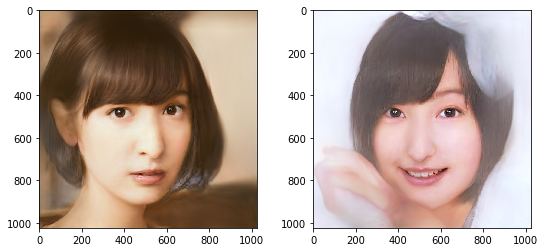

Epoch:  150
Batch:  1
This batch:  ['1_rightstare_01', '5_smiling_01']
Total time elapsed:  240.7549126148224  s
W+ loss:  3609.21484375
Feature loss:  24.865829467773438  | Pixel loss:  0.009224002249538898  | Target prop loss:  0.05153857544064522
Weighted - Feature loss:  2486.5829467773438  | Pixel loss:  92.24002249538898  | Target prop loss:  515.3857544064522
Total loss:  3094.208740234375


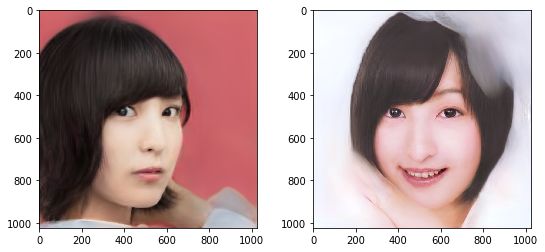

Target W+ output


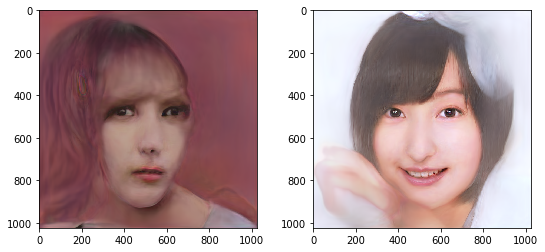

Epoch:  150
Batch:  2
This batch:  ['4_hmm_01', '6_straight_01']
Total time elapsed:  242.08154940605164  s
W+ loss:  3855.3359375
Feature loss:  32.274654388427734  | Pixel loss:  0.010186366736888885  | Target prop loss:  0.05585702881217003
Weighted - Feature loss:  3227.4654388427734  | Pixel loss:  101.86366736888885  | Target prop loss:  558.5702881217003
Total loss:  3887.8994140625


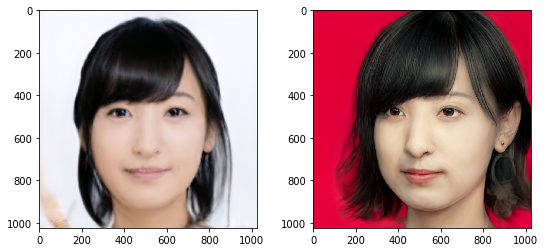

Target W+ output


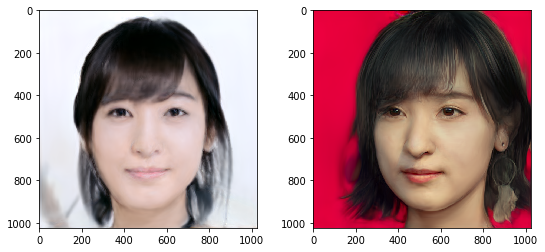

Epoch:  150
Batch:  3
This batch:  ['3_rest_01', '2_staring_01']
Total time elapsed:  243.4641706943512  s
W+ loss:  2539.79541015625
Feature loss:  24.633241653442383  | Pixel loss:  0.015371409244835377  | Target prop loss:  0.0421455018222332
Weighted - Feature loss:  2463.3241653442383  | Pixel loss:  153.71409244835377  | Target prop loss:  421.455018222332
Total loss:  3038.493408203125


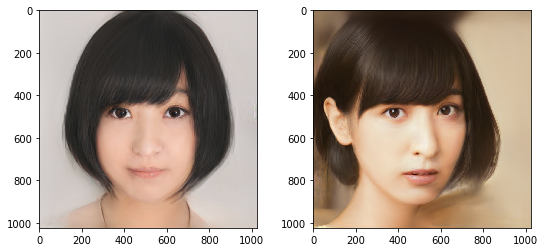

Target W+ output


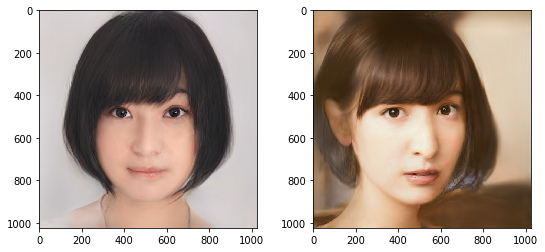

Epoch:  175
Batch:  1
This batch:  ['1_rightstare_01', '6_straight_01']
Total time elapsed:  281.1229131221771  s
W+ loss:  4603.12841796875
Feature loss:  31.220361709594727  | Pixel loss:  0.010247423313558102  | Target prop loss:  0.05768097937107086
Weighted - Feature loss:  3122.0361709594727  | Pixel loss:  102.47423313558102  | Target prop loss:  576.8097937107086
Total loss:  3801.320068359375


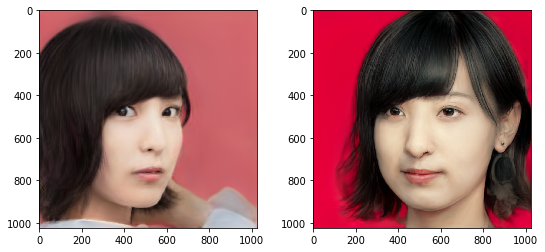

Target W+ output


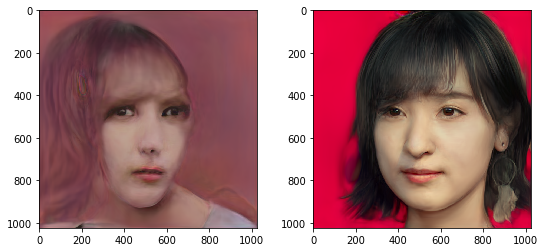

Epoch:  175
Batch:  2
This batch:  ['5_smiling_01', '2_staring_01']
Total time elapsed:  282.45546412467957  s
W+ loss:  3242.14501953125
Feature loss:  30.490901947021484  | Pixel loss:  0.018787667155265808  | Target prop loss:  0.04942798987030983
Weighted - Feature loss:  3049.0901947021484  | Pixel loss:  187.87667155265808  | Target prop loss:  494.2798987030983
Total loss:  3731.24658203125


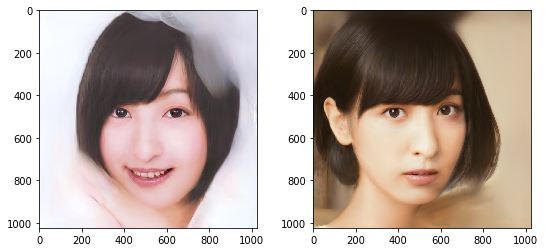

Target W+ output


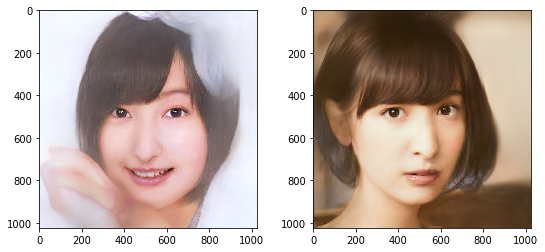

Epoch:  175
Batch:  3
This batch:  ['3_rest_01', '4_hmm_01']
Total time elapsed:  283.7656395435333  s
W+ loss:  2136.35595703125
Feature loss:  19.7412109375  | Pixel loss:  0.0054829977452754974  | Target prop loss:  0.04255664348602295
Weighted - Feature loss:  1974.12109375  | Pixel loss:  54.829977452754974  | Target prop loss:  425.5664348602295
Total loss:  2454.517578125


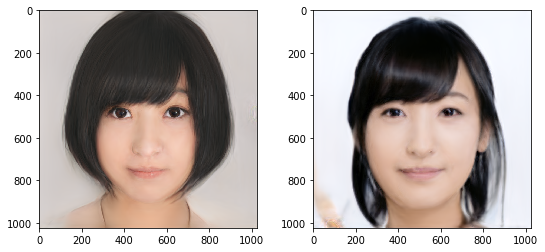

Target W+ output


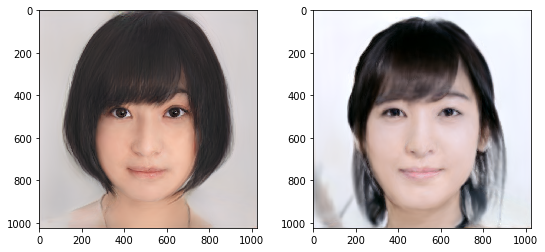

Epoch:  200
Batch:  1
This batch:  ['5_smiling_01', '6_straight_01']
Total time elapsed:  321.4582257270813  s
W+ loss:  4023.4453125
Feature loss:  35.38684844970703  | Pixel loss:  0.012362692505121231  | Target prop loss:  0.057978034019470215
Weighted - Feature loss:  3538.684844970703  | Pixel loss:  123.62692505121231  | Target prop loss:  579.7803401947021
Total loss:  4242.09228515625


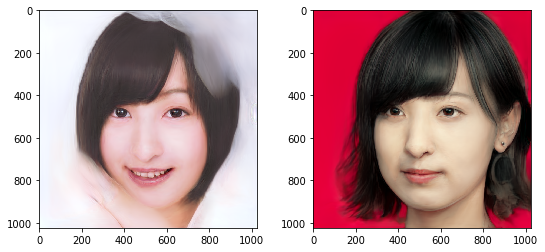

Target W+ output


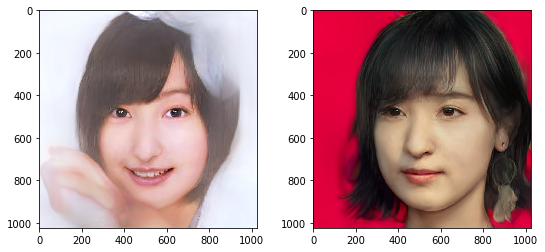

Epoch:  200
Batch:  2
This batch:  ['3_rest_01', '2_staring_01']
Total time elapsed:  322.75298857688904  s
W+ loss:  2526.491455078125
Feature loss:  24.41277503967285  | Pixel loss:  0.01522416528314352  | Target prop loss:  0.04217986389994621
Weighted - Feature loss:  2441.277503967285  | Pixel loss:  152.2416528314352  | Target prop loss:  421.7986389994621
Total loss:  3015.31787109375


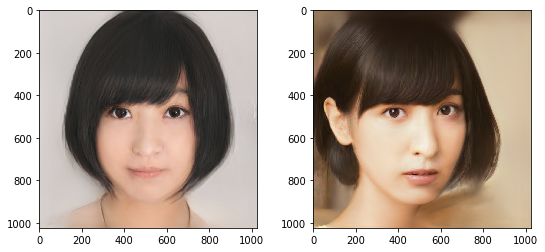

Target W+ output


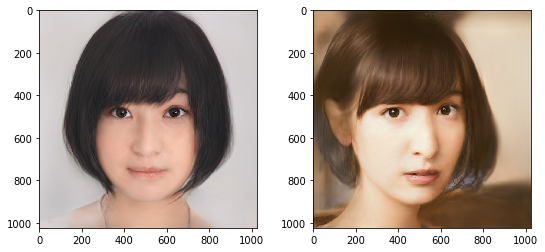

Epoch:  200
Batch:  3
This batch:  ['4_hmm_01', '1_rightstare_01']
Total time elapsed:  324.1129493713379  s
W+ loss:  3404.45947265625
Feature loss:  21.477750778198242  | Pixel loss:  0.006689874920994043  | Target prop loss:  0.04960259422659874
Weighted - Feature loss:  2147.775077819824  | Pixel loss:  66.89874920994043  | Target prop loss:  496.0259422659874
Total loss:  2710.69970703125


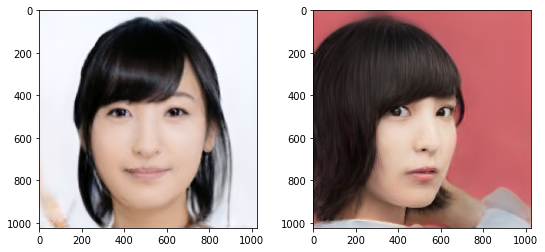

Target W+ output


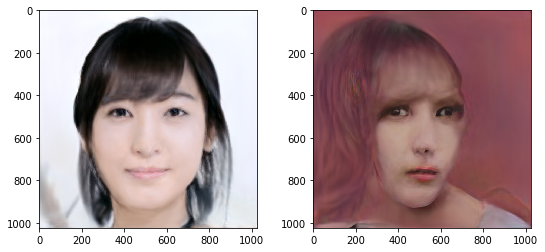

In [4]:
TrainFaceModel(FaceModel, FaceData)

### 5. Save FaceData and FaceModel

In [12]:
DataPath = 'Ayaneru FaceSpace/FaceData.obj'
ModelPath = 'Ayaneru FaceSpace/FaceModel_weights.pth'
SaveFaceSpace(FaceData, DataPath, FaceModel, ModelPath)

FaceData saved to  Ayaneru FaceSpace/FaceData.obj
FaceModel saved to  Ayaneru FaceSpace/FaceModel_weights.pth


### 5b. Load FaceData and FaceModel from saved paths

In [13]:
DataPath = 'Ayaneru FaceSpace/FaceData.obj'
ModelPath = 'Ayaneru FaceSpace/FaceModel_weights.pth'
FaceData, FaceModel = LoadFaceSpace(DataPath, ModelPath)

Getting feature maps for training...
Done
No Zdims explicitly specified, inferring Zdims from FaceData, Zdims=6
Loading model weights from path...
Done


### 6. Show some of the faces generated by the FaceModel
#### Faces based on weighted sum of orthogonal vectors (optional random sum), interpolate between orthogonal vectors for face morphing 

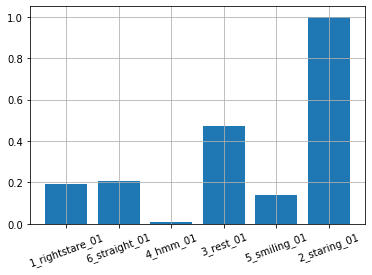

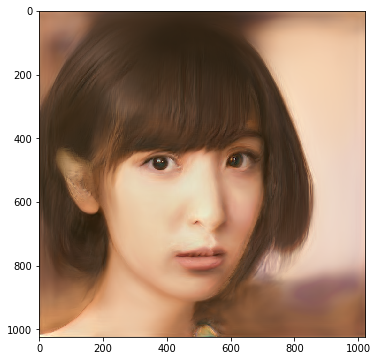

array([0.19422835, 0.20806462, 0.00649549, 0.47445378, 0.14123915,
       1.        ], dtype=float32)

In [16]:
ShowFace(FaceModel, FaceData=FaceData, Random=True)

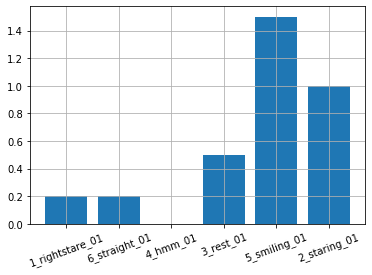

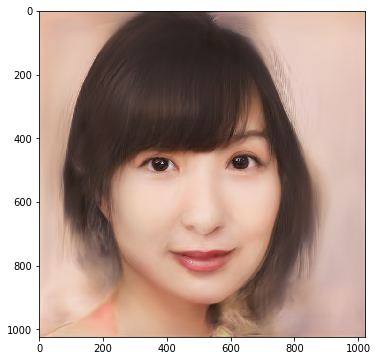

In [21]:
FaceVectors = [0.2,0.2,0,0.5,1.5,1] 
ShowFace(FaceModel, FaceVectors, FaceData=FaceData)

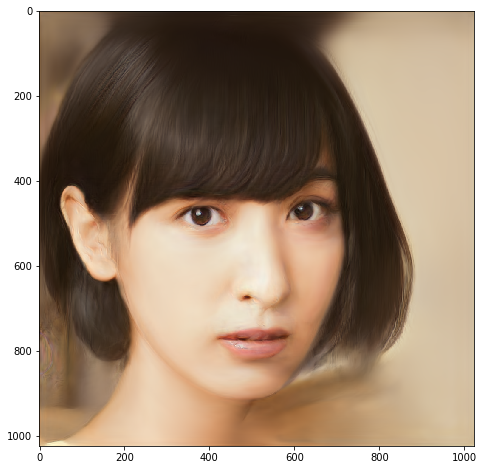

In [28]:
import random
from plot_utils import InterpolateCompressed
FixedLatents = [FixedLatent for FixedLatent in list(FaceData.Zspace[[1,4,3,2,5,0]])]
random.shuffle(FixedLatents)
InterpolateCompressed(FixedLatents, FaceModel, Steps=10)